### 📌 Carga de librerías

En esta celda se importan las principales librerías que se utilizarán para análisis de datos,
visualización, y modelado con `sklearn`. Se incluyen:
- `pandas` y `numpy` para manipulación de datos.
- `matplotlib` y `seaborn` para gráficos.
- Modelos como `RandomForest`, `SVC`, `LogisticRegression`, etc.


In [1]:
# %% Carga de datos y paquetes necesarios
import pandas as pd
import numpy as np

# %% Visualización
import matplotlib.pyplot as plt
import seaborn as sns
from matplotlib_venn import venn3
from statsmodels.graphics.gofplots import qqplot

# %% Estadística y pruebas
from scipy import stats
from scipy.stats import skew

# %% Reducción de dimensionalidad
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
import umap
import umap.umap_ as umap

# %% Preprocesamiento
from sklearn.preprocessing import StandardScaler, PowerTransformer, LabelEncoder
from sklearn.feature_selection import VarianceThreshold

# %% División de datos
from sklearn.model_selection import train_test_split, cross_val_score, cross_validate, StratifiedKFold

# %% Modelos
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.svm import SVC
from sklearn.neural_network import MLPClassifier
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.neighbors import KNeighborsClassifier
from xgboost import XGBClassifier

# %% Métricas y evaluación
from sklearn.metrics import (
    accuracy_score,
    classification_report,
    confusion_matrix,
    ConfusionMatrixDisplay,
    roc_auc_score,
    roc_curve,
    log_loss,
    make_scorer
)
from sklearn.inspection import permutation_importance

# %% Interpretabilidad
import dalex as dx

# %% Otros
from IPython.display import display


c:\Users\ferna\AppData\Local\Programs\Python\Python312\Lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


### 🟩 Celda de Código: Carga e impresión de datos
Primero cargaremos datos de RNA-seq correspondientes a tejidos sanos y tumorales de mama y útero. Todas las muestras han sido obtenidas del proyecto The Cancer Genome Atlas (TCGA), una iniciativa que proporciona datos transcriptómicos estandarizados y de alta calidad para numerosos tipos de cáncer. En este análisis no se han combinado muestras de diferentes proyectos (como GTEx), lo que elimina una de las principales fuentes de heterogeneidad técnica: la procedente del uso de distintos pipelines de procesamiento.

No obstante, es importante destacar que incluso dentro del mismo proyecto TCGA pueden existir otras formas de variabilidad técnica (por ejemplo, entre centros de secuenciación), aunque se espera que el impacto de estas sea mucho menor.

Los valores de expresión génica en estos conjuntos de datos están normalizados en Fragmentos por Kilobase de transcriptos por Millón de lecturas mapeadas (FPKM), una medida que permite la comparación de niveles de expresión entre genes y muestras. Estas medidas de expresión génica serán utilizadas como variables de entrada (features) para el entrenamiento y validación de distintos modelos de aprendizaje automático.

Los conjuntos de datos se cargan de la siguiente forma:

In [2]:
# TEJIDO SANO MAMA: Carga los datos de expresión génica del tejido mamario sano
normal_mama = pd.read_csv('data/brca-rsem-fpkm-tcga.txt', sep='\t')

# TEJIDO SANO ÚTERO: Carga los datos de expresión génica del tejido uterino sano
normal_utero = pd.read_csv('data/ucec-rsem-fpkm-tcga.txt', sep='\t')

# TEJIDO CON CÁNCER MAMA: Carga los datos de expresión génica del tejido mamario con cáncer
cancer_mama = pd.read_csv('data/brca-rsem-fpkm-tcga-t.txt', sep='\t')

# TEJIDO CON CÁNCER ÚTERO: Carga los datos de expresión génica del tejido uterino con cáncer
cancer_utero = pd.read_csv('data/ucec-rsem-fpkm-tcga-t.txt', sep='\t')

In [3]:
# Mostrar las primeras filas de cada DataFrame para verificar la correcta carga de datos
print("🟩 Datos de tejido mamario sano:")
display(normal_mama.head())

print("🟩 Datos de tejido uterino sano:")
display(normal_utero.head())

print("🟥 Datos de tejido mamario con cáncer:")
display(cancer_mama.head())

print("🟥 Datos de tejido uterino con cáncer:")
display(cancer_utero.head())


🟩 Datos de tejido mamario sano:


,Hugo_Symbol,Entrez_Gene_Id,TCGA-BH-A1EU-11A-23R-A137-07,TCGA-BH-A1EO-11A-31R-A137-07,TCGA-BH-A0DZ-11A-22R-A089-07,TCGA-BH-A204-11A-53R-A157-07,TCGA-BH-A0H7-11A-13R-A089-07,TCGA-BH-A209-11A-42R-A157-07,TCGA-BH-A0BW-11A-12R-A115-07,TCGA-BH-A1EV-11A-24R-A137-07,...,TCGA-BH-A0B8-11A-41R-A089-07,TCGA-E2-A1BC-11A-32R-A12P-07,TCGA-E9-A1N4-11A-33R-A14M-07,TCGA-BH-A0DV-11A-22R-A12P-07,TCGA-BH-A1FJ-11B-42R-A13Q-07,TCGA-A7-A0CE-11A-21R-A089-07,TCGA-E9-A1NA-11A-33R-A144-07,TCGA-BH-A0HA-11A-31R-A12P-07,TCGA-BH-A0DQ-11A-12R-A089-07,TCGA-A7-A13F-11A-42R-A12P-07
0,KIF1C,10749,1674.06,2645.74,1295.13,2417.67,1340.84,1697.45,1037.29,1340.84,...,3982.99,1896.65,1191.69,1277.29,830.75,1540.37,3820.70,1023.00,1709.26,1909.85
1,SWAP70,23075,1088.92,967.76,629.35,1111.82,738.29,1159.07,1417.35,1127.35,...,802.41,571.05,1369.04,1322.37,1662.49,595.34,909.17,1111.82,915.51,981.29
2,PAK1,5058,748.61,454.09,679.29,336.79,595.34,674.59,941.27,656.11,...,368.65,279.14,693.58,660.68,629.35,796.86,651.58,693.58,954.43,551.56
3,KRTAP9-1,728318,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,...,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
4,PLEKHM3,389072,110.43,21.01,12.74,120.10,40.64,90.77,100.13,108.14,...,141.02,63.00,101.54,87.65,60.82,18.29,116.78,100.13,80.57,93.35


🟩 Datos de tejido uterino sano:


,Hugo_Symbol,Entrez_Gene_Id,TCGA-FL-A1YT-11A-12R-A32Y-07,TCGA-AX-A0IZ-11A-11R-A27V-07,TCGA-AX-A2HC-11A-11R-A32Y-07,TCGA-BK-A4ZD-11A-12R-A27V-07,TCGA-FL-A1YL-11A-11R-A16F-07,TCGA-FL-A3WE-11A-11R-A22K-07,TCGA-FL-A1YF-11A-12R-A16F-07,TCGA-FL-A1YU-11A-11R-A32Y-07,...,TCGA-AJ-A3NE-11A-11R-A22K-07,TCGA-FL-A1YN-11A-11R-A32Y-07,TCGA-FL-A1YV-11A-12R-A32Y-07,TCGA-FL-A1YQ-11A-11R-A32Y-07,TCGA-BG-A3PP-11A-11R-A22K-07,TCGA-AX-A05Y-11A-11R-A27V-07,TCGA-AJ-A3NH-11A-11R-A22K-07,TCGA-DI-A2QY-11A-11R-A19W-07,TCGA-FL-A1YI-11A-11R-A16F-07,TCGA-BG-A3EW-11A-22R-A22K-07
0,PDGFD,80310,521.76,780.44,158.79,141.02,547.75,105.89,175.07,105.15,...,265.87,287.01,214.27,140.04,1447.15,470.14,223.41,91.41,190.34,193.01
1,SHANK3,85358,312.00,281.09,400.71,511.00,260.38,253.23,303.44,267.73,...,447.82,591.22,157.68,236.21,36.53,406.31,177.53,93.35,387.02,379.04
2,FABP3,2170,708.18,1277.29,5076.84,3491.39,429.54,1540.37,587.13,351.14,...,674.59,769.69,571.05,665.29,866.07,1617.00,884.29,915.51,802.41,3372.43
3,TSPAN4,7106,2777.33,3901.01,4010.71,1832.01,2193.99,1583.71,2835.70,1540.37,...,1674.06,2417.67,3257.52,1359.57,3103.19,2855.44,1216.75,967.76,2240.11,4388.98
4,HIST1H2BJ,8970,33.06,71.00,20.26,37.32,24.81,10.63,29.48,63.45,...,59.55,35.50,41.22,61.68,9.56,26.47,100.13,98.73,51.35,57.89


🟥 Datos de tejido mamario con cáncer:


,Hugo_Symbol,Entrez_Gene_Id,TCGA-AC-A2BM-01A-11R-A21T-07,TCGA-A8-A075-01A-11R-A084-07,TCGA-A2-A0EM-01A-11R-A034-07,TCGA-A7-A3J1-01A-11R-A213-07,TCGA-BH-A0BO-01A-23R-A12D-07,TCGA-A8-A08L-01A-11R-A00Z-07,TCGA-AN-A0FW-01A-11R-A034-07,TCGA-E2-A1L9-01A-11R-A13Q-07,...,TCGA-E2-A14R-01A-11R-A115-07,TCGA-A2-A0EU-01A-22R-A056-07,TCGA-EW-A1P0-01A-11R-A144-07,TCGA-A1-A0SM-01A-11R-A084-07,TCGA-BH-A1FR-01A-11R-A13Q-07,TCGA-A1-A0SB-01A-11R-A144-07,TCGA-A7-A13E-01A-11R-A12P-07,TCGA-AN-A0FY-01A-11R-A034-07,TCGA-A2-A1G0-01A-11R-A13Q-07,TCGA-A8-A08H-01A-21R-A00Z-07
0,KIF1C,10749,974.50,1225.22,1304.15,1794.29,1561.89,480.04,909.17,848.22,...,595.34,848.22,1081.39,1709.26,426.57,1096.50,3235.01,1051.79,1081.39,1388.16
1,SWAP70,23075,387.02,575.03,733.19,633.73,1674.06,426.57,289.02,547.75,...,241.19,688.78,447.82,660.68,547.75,647.07,518.15,954.43,723.08,988.12
2,PAK1,5058,748.61,693.58,1583.71,1059.11,1015.93,173.85,860.08,1001.93,...,941.27,638.15,206.94,3874.05,848.22,698.41,2555.58,1008.90,1037.29,954.43
3,KRTAP9-1,728318,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,...,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
4,PLEKHM3,389072,31.22,23.25,22.43,48.87,31.45,55.89,17.25,10.39,...,9.41,7.82,28.65,16.39,26.10,105.15,42.41,14.89,53.57,39.79


🟥 Datos de tejido uterino con cáncer:


,Hugo_Symbol,Entrez_Gene_Id,TCGA-AX-A2IN-01A-12R-A180-07,TCGA-EO-A22U-01A-11R-A180-07,TCGA-AJ-A3NF-01A-11R-A22K-07,TCGA-SJ-A6ZI-01A-12R-A34R-07,TCGA-AJ-A5DW-01A-11R-A27V-07,TCGA-BK-A4ZD-01A-11R-A27V-07,TCGA-EY-A2OQ-01A-11R-A19W-07,TCGA-B5-A3F9-01A-21R-A22K-07,...,TCGA-PG-A5BC-01A-12R-A27V-07,TCGA-D1-A3JQ-01A-11R-A22K-07,TCGA-D1-A3DH-01A-11R-A19W-07,TCGA-B5-A11R-01A-11R-A118-07,TCGA-D1-A3DG-01A-11R-A19W-07,TCGA-PG-A915-01A-11R-A37O-07,TCGA-EY-A1GX-01A-12R-A13S-07,TCGA-AJ-A3IA-01A-11R-A213-07,TCGA-EO-A22Y-01A-11R-A180-07,TCGA-AJ-A3EK-01A-11R-A19W-07
0,PDGFD,80310,81.71,19.53,193.01,95.34,55.10,20.71,43.02,148.09,...,224.97,158.79,34.02,59.97,33.54,47.84,329.84,20.11,55.10,25.35
1,SHANK3,85358,122.64,57.49,201.25,113.56,100.13,25.35,73.03,81.71,...,99.43,87.65,42.11,90.77,64.34,84.04,102.25,91.41,100.13,58.71
2,FABP3,2170,190.34,371.22,4671.57,78.89,231.32,82.87,211.31,500.46,...,703.28,2816.11,99.43,612.11,260.38,825.00,59.13,289.02,543.96,135.24
3,TSPAN4,7106,1594.73,426.57,1417.35,587.13,466.88,351.14,896.64,551.56,...,775.05,2090.03,748.61,332.14,909.17,559.28,457.25,674.59,703.28,651.58
4,HIST1H2BJ,8970,161.02,231.32,65.26,209.84,460.44,23.25,78.34,127.00,...,109.66,511.00,2.56,500.46,18.43,70.01,267.73,197.09,536.45,120.10


### Explicación de la carga y verificación de datos de oncogenes y genes supresores

1. **Carga de la lista de oncogenes desde un archivo Excel**  
   Se utiliza la función `pd.read_excel` de pandas para cargar un archivo Excel (`NCG6_tsgoncogene.xlsx`) que se encuentra en la carpeta `data`.  
   - Se especifica el parámetro `engine='openpyxl'` para indicar el motor que se utilizará en la lectura del archivo.
   - Este archivo contiene información acerca de genes que se han asociado con el cáncer, incluyendo tanto oncogenes (genes que, al mutar o expresarse de forma desregulada, pueden inducir el cáncer) como genes supresores de tumores (genes que ayudan a prevenir la formación de tumores).

2. **Visualización de los primeros registros**  
   La función `head()` se utiliza para imprimir las primeras filas del DataFrame `cancer_genes`.  
   - Esto permite verificar que los datos se hayan cargado correctamente desde el archivo Excel.
   - Se imprime un mensaje descriptivo antes de los datos para facilitar su identificación en la salida.

3. **Verificación de la estructura del DataFrame**  
   Se llama al método `info()` para mostrar un resumen informativo sobre el DataFrame.  
   


In [4]:
# Carga del archivo Excel
cancer_genes = pd.read_excel('data/tsgoncogene.xlsx', engine='openpyxl')

# Mostrar las primeras filas para verificar su contenido
print("🧬 Datos de oncogenes y genes supresores de tumores:")
display(cancer_genes.head())

# Mostrar información estructural del DataFrame
print("📊 Información general del DataFrame:")
cancer_genes.info()

🧬 Datos de oncogenes y genes supresores de tumores:


,entrez,symbol,pubmed_id,type,primary_site,cancer_type,method
0,25,ABL1,29625053,WES,multiple,pan-cancer_adult,PanSoftWare
1,25,ABL1,14993899,Known Cancer,multiple,-,-
2,25,ABL1,29489755,WGS-WES-RNAseq,multiple,pan-cancer_paediatric,"GRIN, MutSig"
3,25,ABL1,23539594,Known Cancer,multiple,-,-
4,27,ABL2,14993899,Known Cancer,multiple,-,-


📊 Información general del DataFrame:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6536 entries, 0 to 6535
Data columns (total 7 columns):
 #   Column        Non-Null Count  Dtype 
---  ------        --------------  ----- 
 0   entrez        6536 non-null   int64 
 1   symbol        6536 non-null   object
 2   pubmed_id     6536 non-null   int64 
 3   type          6536 non-null   object
 4   primary_site  6536 non-null   object
 5   cancer_type   6536 non-null   object
 6   method        6536 non-null   object
dtypes: int64(2), object(5)
memory usage: 357.6+ KB


### Explicación del código para comprobar valores duplicados en una columna

El fragmento de código realiza las siguientes operaciones:

1. **Definición de la función `check_duplicates`:**  
   - **Propósito:** Detectar y mostrar los valores duplicados (aquellos que aparecen más de una vez) en una columna específica de un DataFrame.  
   - **Parámetros:**  
     - `df`: Un DataFrame de Pandas.
     - `column_name`: El nombre de la columna en la que se desea buscar duplicados.
   - **Proceso Interno:**  
     - Utiliza el método `value_counts()` para contar la cantidad de ocurrencias de cada valor en la columna indicada.
     - Filtra esos resultados para quedarse únicamente con aquellos valores cuya frecuencia es mayor a 1 (es decir, que se repiten).
   - **Retorno:**  
     - Devuelve un objeto `Series` que contiene los valores duplicados y su respectiva frecuencia.

2. **Comprobación de duplicados en el DataFrame `cancer_mama`:**  
   Se realizan dos comprobaciones específicas:
   
   - **Duplicados en 'Hugo_Symbol':**  
     - Se aplica la función `check_duplicates` a la columna 'Hugo_Symbol' del DataFrame `cancer_mama`, lo que permite detectar nombres de genes que se repiten.
     - Se imprime el número total de valores duplicados (es decir, la cantidad de diferentes símbolos que se repiten).
     - Si existen duplicados, se imprime un listado de cada valor duplicado junto con la cantidad de veces que aparece.
   
   - **Duplicados en 'Entrez_Gene_Id':**  
     - De manera similar, se utiliza la función para comprobar duplicados en la columna 'Entrez_Gene_Id'.  
     - Se muestra la cantidad de identificadores numéricos duplicados.
     - En caso de encontrar duplicados, se imprime la lista de dichos identificadores y su frecuencia.

Esta estrategia es muy útil para identificar problemas en la calidad de los datos, como registros de genes que estén repetidos, lo cual puede afectar análisis posteriores en estudios de expresión génica.


In [5]:
# Función para comprobar valores duplicados en una columna específica de un DataFrame
def check_duplicates(df, column_name):
    """
    Función que detecta valores duplicados en una columna específica de un DataFrame.
    
    Parámetros:
    - df: DataFrame de Pandas.
    - column_name: Nombre de la columna donde se buscarán duplicados.

    Retorna:
    - Un Series con los valores repetidos y su frecuencia.
    """
    duplicates = df[column_name].value_counts()  # Cuenta la frecuencia de cada valor en la columna
    duplicates = duplicates[duplicates > 1]  # Filtra solo los valores que aparecen más de una vez
    return duplicates

# Comprobación de duplicados en los datos de cáncer de mama

# Comprobar Hugo Symbols repetidos (nombres de genes)
hugo_symbols_repetidos = check_duplicates(cancer_mama, 'Hugo_Symbol')
print("Número de Hugo Symbols repetidos:", len(hugo_symbols_repetidos))

# Mostrar los valores repetidos si existen
if not hugo_symbols_repetidos.empty:
    print("Hugo Symbols duplicados y su frecuencia:")
    print(hugo_symbols_repetidos)

# Comprobar identificadores numéricos repetidos (ID de genes en la base de datos Entrez)
genes_id_repetidos = check_duplicates(cancer_mama, 'Entrez_Gene_Id')
print("Número de identificadores numéricos repetidos:", len(genes_id_repetidos))

# Mostrar los valores repetidos si existen
if not genes_id_repetidos.empty:
    print("Identificadores Entrez duplicados y su frecuencia:")
    print(genes_id_repetidos)


Número de Hugo Symbols repetidos: 0
Número de identificadores numéricos repetidos: 183
Identificadores Entrez duplicados y su frecuencia:
Entrez_Gene_Id
0         1123
8294        14
8350        10
122183       5
9503         5
          ... 
11013        2
30014        2
9729         2
401251       2
6139         2
Name: count, Length: 183, dtype: int64





### 🧬 **Filtrado de genes asociados al cáncer**

Con el fin de reducir la dimensionalidad del conjunto de datos y enfocar el análisis en genes biológicamente relevantes, se procede a filtrar las matrices de expresión génica para conservar únicamente aquellos genes que han sido previamente identificados como **oncogenes** o **genes supresores de tumores**. Esta información se extrae de una fuente externa, en este caso una tabla con anotaciones genéticas que incluye los símbolos genéticos (`symbol`) y sus respectivos identificadores Entrez (`entrez`).

Este filtrado tiene varias ventajas clave:

- **Reduce el ruido** presente en los datos al eliminar genes irrelevantes.
- **Mejora la interpretabilidad biológica** de los resultados.
- **Facilita el entrenamiento de modelos** de aprendizaje automático, al reducir el número de variables (genes) de entrada.

Para ello, se define una función `filter_data` que realiza las siguientes operaciones:

1. **Filtra** los genes del `DataFrame` de expresión para conservar solo aquellos cuyos identificadores Entrez estén presentes en la tabla de genes relacionados con cáncer.
2. **Detecta posibles duplicados** de genes en base al identificador Entrez.
3. En caso de duplicados, **conserva solamente aquellos registros** cuyo nombre (`Hugo_Symbol`) coincida con el nombre esperado en la lista de genes del cáncer, eliminando así posibles redundancias o inconsistencias.
4. Finalmente, se establece el identificador `Entrez_Gene_Id` como índice del `DataFrame`, facilitando futuras operaciones de análisis y visualización.

Este proceso se aplica por separado a cada uno de los conjuntos de datos (tumorales y sanos, de mama y útero), y se imprime la cantidad resultante de genes en cada uno de ellos. Esto permite confirmar que el filtrado se ha llevado a cabo correctamente.

Este paso es esencial para asegurar que el análisis posterior —ya sea estadístico o basado en modelos de machine learning— se realice sobre un conjunto de genes con alta relevancia biológica.


In [6]:
# Función para filtrar datos de expresión génica basados en la lista de genes asociados al cáncer
def filter_data(df, cancer_genes):
    """
    Filtra los datos de expresión génica para incluir solo los genes presentes en la lista de oncogenes.
    
    Parámetros:
    - df: DataFrame con datos de expresión génica.
    - cancer_genes: DataFrame con genes asociados al cáncer (contiene columnas 'entrez' y 'symbol').

    Retorna:
    - DataFrame filtrado con genes únicos según 'Entrez_Gene_Id'.
    """
    
    # Filtrar solo los genes presentes en la lista de oncogenes (basado en 'Entrez_Gene_Id')
    df = df[df['Entrez_Gene_Id'].isin(cancer_genes['entrez'])]

    # Identificar genes duplicados en 'Entrez_Gene_Id'
    rep = df['Entrez_Gene_Id'].value_counts()
    rep = rep[rep > 1].index  # Lista de genes duplicados

    # Resolver duplicados: mantener aquellos que coincidan con 'Hugo_Symbol' en la lista de oncogenes
    df = df[(~df['Entrez_Gene_Id'].isin(rep)) | 
            (df['Hugo_Symbol'].isin(cancer_genes[cancer_genes['entrez'].isin(rep)]['symbol']))]

    # Establecer 'Entrez_Gene_Id' como índice para facilitar el análisis
    df.set_index('Entrez_Gene_Id', inplace=True)

    return df

# Aplicar el filtrado a los datasets de tejido tumoral y normal
tumor_A = filter_data(cancer_mama, cancer_genes)  # Cáncer de mama
tumor_B = filter_data(cancer_utero, cancer_genes)  # Cáncer de útero
normal_A = filter_data(normal_mama, cancer_genes)  # Tejido mamario sano
normal_B = filter_data(normal_utero, cancer_genes)  # Tejido uterino sano

# Verificar la cantidad de genes después del filtrado
print("Número de genes en tumor de mama:", tumor_A.shape[0])
print("Número de genes en tumor de útero:", tumor_B.shape[0])
print("Número de genes en tejido mamario sano:", normal_A.shape[0])
print("Número de genes en tejido uterino sano:", normal_B.shape[0])


Número de genes en tumor de mama: 2307
Número de genes en tumor de útero: 2281
Número de genes en tejido mamario sano: 2307
Número de genes en tejido uterino sano: 2281



### 🔀 División del conjunto de datos: función `split_data`

Para poder entrenar y evaluar modelos de aprendizaje automático de forma efectiva, es necesario dividir los datos disponibles en dos subconjuntos: uno para **entrenamiento** y otro para **prueba**. Esto se realiza mediante la función `split_data`, definida a continuación.

#### ⚙️ Propósito de la función

La función `split_data` toma un `DataFrame` de expresión génica y lo divide horizontalmente (por columnas) en dos subconjuntos. Las **dos primeras columnas** del `DataFrame` original se preservan sin cambios, ya que normalmente contienen información descriptiva o identificadores de genes (por ejemplo, `Hugo_Symbol` y `Entrez_Gene_Id`).

#### 📥 Parámetros

- `df`: El `DataFrame` completo que contiene las expresiones génicas.
- `test_size`: Proporción del total de columnas que se destinarán al conjunto de prueba. Por defecto es 0.25 (25%).
- `random_state`: Semilla aleatoria para asegurar la **reproducibilidad** de la partición.

#### 🔧 Proceso

1. **Selección de columnas de datos**:  
   Se excluyen las dos primeras columnas (`df.iloc[:, 2:]`) para aplicar la división solo sobre las columnas de expresión génica.

2. **División de índices de columnas**:  
   Se usa `train_test_split` para seleccionar aleatoriamente qué columnas se incluirán en los subconjuntos de entrenamiento y prueba.

3. **Reconstrucción de los subconjuntos**:  
   Las columnas seleccionadas se combinan nuevamente con las dos primeras columnas originales, formando `df_train` y `df_test`.

#### 🔁 Salida

La función devuelve dos `DataFrames`:

- `df_train`: Conjunto de entrenamiento con las dos primeras columnas + columnas seleccionadas para entrenamiento.
- `df_test`: Conjunto de prueba con las dos primeras columnas + columnas seleccionadas para test.

Este procedimiento permite preparar correctamente los datos para construir y validar modelos sin perder información clave de los identificadores génicos.


In [7]:
# Función para dividir los datos en conjuntos de entrenamiento y prueba
def split_data(df, test_size=0.20, random_state=900888):
    """
    Divide el conjunto de datos en entrenamiento y prueba, manteniendo las dos primeras columnas intactas.
    
    Parámetros:
    - df: DataFrame con los datos a dividir.
    - test_size: Proporción de datos a usar como conjunto de prueba (por defecto 25%).
    - random_state: Semilla para la aleatorización (para reproducibilidad).

    Retorna:
    - df_train: DataFrame de entrenamiento.
    - df_test: DataFrame de prueba.
    """
    
    # Excluir las dos primeras columnas (normalmente identificadores de genes)
    df_data = df.iloc[:, 2:]
    
    # Dividir índices de columnas en entrenamiento y prueba
    train_idx, test_idx = train_test_split(
        range(df_data.shape[1]), test_size=test_size, random_state=random_state
    )

    # Reconstruir los DataFrames incluyendo las dos primeras columnas
    df_train = pd.concat([df.iloc[:, :2], df_data.iloc[:, train_idx]], axis=1)
    df_test = pd.concat([df.iloc[:, :2], df_data.iloc[:, test_idx]], axis=1)

    return df_train, df_test


## 🧠 Clasificación tumor-normal

El siguiente diagrama resume el flujo general para un sistema de clasificación utilizando datos transcriptómicos:

![Clasificación tumor-normal](IMAGEN1.jpeg)

1. **Importación de datos:** Se integran perfiles de expresión génica provenientes de TCGA (tejidos tumorales) y GTEx (tejidos normales).
2. **División del conjunto de datos:** Los datos se dividen en subconjuntos de entrenamiento y prueba.
3. **Entrenamiento del modelo:** Se aplican algoritmos de machine learning utilizando los datos de entrenamiento.
4. **Predicción:** El modelo aprende a distinguir entre muestras tumorales y normales, y luego se evalúa su rendimiento con los datos de prueba.


Gracias, aquí tienes la **traducción del código R a Python** junto con una **explicación detallada en formato Markdown**. Vamos primero con la **explicación**.

---

### 🧬 Composición del conjunto de entrenamiento: muestras tumorales y normales

Una vez divididos los datos en conjuntos de entrenamiento, es necesario preparar una matriz final que agrupe todas las muestras tumorales y normales de los distintos tejidos. En este caso, trabajamos con datos de cáncer de mama y útero. El objetivo es construir una **matriz consolidada** que se usará para entrenar modelos de clasificación.

#### 🔹 Paso 1: Igualar genes entre tejidos

Antes de combinar las matrices de diferentes tejidos, es importante asegurarse de que **ambos conjuntos (A y B)** contienen los **mismos genes**. Esto se hace tomando la intersección de los identificadores (`Entrez_Gene_Id`) entre ambos conjuntos para asegurar la compatibilidad.

#### 🔹 Paso 2: Combinar muestras

Una vez alineados los genes, se **combinan horizontalmente** (por columnas) las muestras tumorales de los dos tejidos en un solo `DataFrame`, y lo mismo se hace con las muestras normales. A continuación, se transpone la matriz resultante para que cada **fila represente una muestra** y cada **columna un gen**, como requiere la mayoría de algoritmos de aprendizaje automático.

#### 🔹 Paso 3: Verificación y renombrado

Se verifica que ambas matrices (tumoral y normal) tienen el mismo número y orden de columnas (genes). Luego, se combinan verticalmente (`rbind` en R, `concat` en Python), formando la matriz final de entrenamiento.

Cada columna de genes se renombra con el prefijo `g_` para estandarizar los nombres. Por último, se añade una columna `type` que etiqueta cada muestra como `'Tumor'` o `'Normal'`.

Este procedimiento asegura que el modelo de clasificación trabajará con una matriz bien estructurada, sin discrepancias entre los conjuntos de datos.



In [8]:
# Aplicar la división en conjuntos de entrenamiento y prueba a cada dataset
# Cáncer de mama
tumor_A_train, tumor_A_test = split_data(tumor_A)
print(f"Tumor de mama - Train: {tumor_A_train.shape}, Test: {tumor_A_test.shape}")

# Cáncer de útero
tumor_B_train, tumor_B_test = split_data(tumor_B)
print(f"Tumor de útero - Train: {tumor_B_train.shape}, Test: {tumor_B_test.shape}")

# Tejido mamario sano
normal_A_train, normal_A_test = split_data(normal_A)
print(f"Tejido mamario sano - Train: {normal_A_train.shape}, Test: {normal_A_test.shape}")

# Tejido uterino sano
normal_B_train, normal_B_test = split_data(normal_B)
print(f"Tejido uterino sano - Train: {normal_B_train.shape}, Test: {normal_B_test.shape}")


Tumor de mama - Train: (2307, 786), Test: (2307, 199)
Tumor de útero - Train: (2281, 114), Test: (2281, 30)
Tejido mamario sano - Train: (2307, 89), Test: (2307, 24)
Tejido uterino sano - Train: (2281, 19), Test: (2281, 7)


### 📄Construcción del conjunto de prueba



In [9]:
# Asegurar que los genes son comunes entre ambos tejidos tumorales
common_genes_tumor = tumor_A_train.index.intersection(tumor_B_train.index)
tumor_A_train = tumor_A_train.loc[common_genes_tumor]
tumor_B_train = tumor_B_train.loc[common_genes_tumor]

# Combinar y transponer las muestras tumorales
tumor_train_set = pd.concat([
    tumor_A_train.iloc[:, 2:],  # Excluyendo las columnas 'Hugo_Symbol' y 'Entrez_Gene_Id'
    tumor_B_train.iloc[:, 2:]
], axis=1).T

# Asegurar que los genes son comunes entre ambos tejidos normales
common_genes_normal = normal_A_train.index.intersection(normal_B_train.index)
normal_A_train = normal_A_train.loc[common_genes_normal]
normal_B_train = normal_B_train.loc[common_genes_normal]

# Combinar y transponer las muestras normales
normal_train_set = pd.concat([
    normal_A_train.iloc[:, 2:],
    normal_B_train.iloc[:, 2:]
], axis=1).T

# Verificaciones: columnas (genes) deben coincidir en número y orden
assert tumor_train_set.shape[1] == normal_train_set.shape[1], "Número de genes no coincide"
assert (tumor_train_set.columns == normal_train_set.columns).all(), "Los genes no están en el mismo orden"

# Unir ambas matrices de muestras
train_set = pd.concat([tumor_train_set, normal_train_set], axis=0)

# Renombrar columnas de genes con prefijo 'g_'
train_set.columns = [f"g_{gene}" for gene in train_set.columns]

# Añadir columna de tipo (etiqueta de clase)
train_set["type"] = pd.Categorical(
    ["Tumor"] * tumor_train_set.shape[0] + ["Normal"] * normal_train_set.shape[0],
    categories=["Normal", "Tumor"]
)


### 📄Construcción del conjunto de entrenamiento

In [10]:
# Asegurar que los genes son comunes entre ambos tejidos tumorales (test)
common_genes_tumor_test = tumor_A_test.index.intersection(tumor_B_test.index)
tumor_A_test = tumor_A_test.loc[common_genes_tumor_test]
tumor_B_test = tumor_B_test.loc[common_genes_tumor_test]

# Combinar y transponer las muestras tumorales (test)
tumor_test_set = pd.concat([
    tumor_A_test.iloc[:, 2:],  # Excluir columnas 'Hugo_Symbol' y 'Entrez_Gene_Id'
    tumor_B_test.iloc[:, 2:]
], axis=1).T

# Asegurar que los genes son comunes entre ambos tejidos normales (test)
common_genes_normal_test = normal_A_test.index.intersection(normal_B_test.index)
normal_A_test = normal_A_test.loc[common_genes_normal_test]
normal_B_test = normal_B_test.loc[common_genes_normal_test]

# Combinar y transponer las muestras normales (test)
normal_test_set = pd.concat([
    normal_A_test.iloc[:, 2:],
    normal_B_test.iloc[:, 2:]
], axis=1).T

# Verificar que las columnas (genes) coincidan en nombre y orden
assert tumor_test_set.shape[1] == normal_test_set.shape[1], "Número de genes no coincide"
assert (tumor_test_set.columns == normal_test_set.columns).all(), "Los genes no están en el mismo orden"

# Unir ambas matrices de muestras
test_set = pd.concat([tumor_test_set, normal_test_set], axis=0)

# Renombrar columnas con prefijo 'g_'
test_set.columns = [f"g_{gene}" for gene in test_set.columns]

# Añadir columna de tipo (etiqueta de clase)
test_set["type"] = pd.Categorical(
    ["Tumor"] * tumor_test_set.shape[0] + ["Normal"] * normal_test_set.shape[0],
    categories=["Normal", "Tumor"]
)

Perfecto. Aquí tienes primero la **explicación en Markdown** para tu documentación, y luego te paso el **código en Python** en el siguiente mensaje.

---

### 📊 Análisis de distribución de clases en los conjuntos de datos

Antes de entrenar un modelo de clasificación, es esencial analizar cómo están distribuidas las muestras en los conjuntos de entrenamiento (`train_set`) y prueba (`test_set`). Este paso permite detectar si hay **desequilibrios de clase** que puedan influir en el rendimiento del modelo, especialmente en métricas como accuracy o AUC.

#### 🔍 ¿Qué se analiza?

1. **Conteo absoluto** de muestras etiquetadas como `Tumor` y `Normal`.
2. **Porcentaje** de cada clase dentro del conjunto.
3. **Visualización gráfica** mediante diagramas de barras para facilitar la interpretación.

#### ✅ ¿Por qué es importante?

- Si una clase es mucho más numerosa que la otra, el modelo podría **aprender a sesgarse** hacia la clase mayoritaria.
- Detectar esto a tiempo permite aplicar estrategias correctivas como **balanceo**, **ponderación de clases**, o técnicas de **resampling**.

Este análisis preliminar es una **buena práctica estándar** en cualquier flujo de trabajo de aprendizaje automático supervisado.



### 📦 **Bloque 1: Conteo absoluto y porcentual por clase**


In [11]:
# Conteo de clases en el conjunto de entrenamiento
train_counts = train_set["type"].value_counts()
train_props = train_set["type"].value_counts(normalize=True) * 100

print("📊 Distribución en el conjunto de entrenamiento:")
print(train_counts)
print("\nProporción (%):")
print(train_props.round(2))

# Conteo de clases en el conjunto de prueba
test_counts = test_set["type"].value_counts()
test_props = test_set["type"].value_counts(normalize=True) * 100

print("\n📊 Distribución en el conjunto de prueba:")
print(test_counts)
print("\nProporción (%):")
print(test_props.round(2))


📊 Distribución en el conjunto de entrenamiento:
type
Tumor     896
Normal    104
Name: count, dtype: int64

Proporción (%):
type
Tumor     89.6
Normal    10.4
Name: proportion, dtype: float64

📊 Distribución en el conjunto de prueba:
type
Tumor     225
Normal     27
Name: count, dtype: int64

Proporción (%):
type
Tumor     89.29
Normal    10.71
Name: proportion, dtype: float64




### 📊 **Bloque 2: Visualización de la distribución de clases**


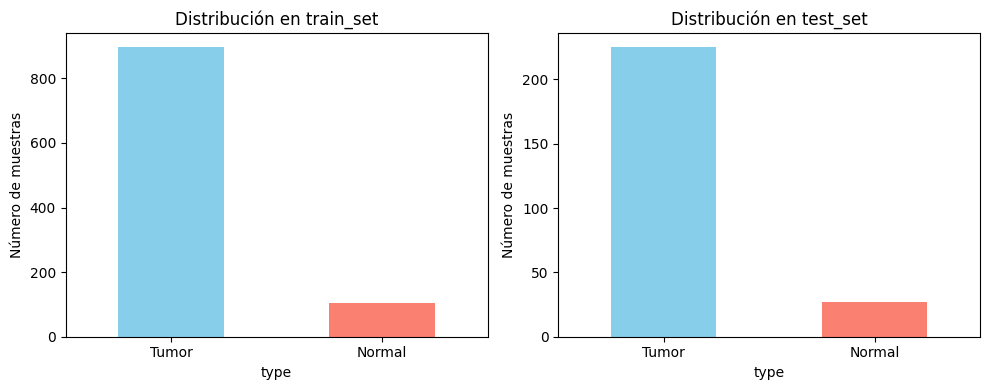

In [12]:
# Crear figura y subgráficos
fig, axes = plt.subplots(1, 2, figsize=(10, 4))

# Gráfico para el conjunto de entrenamiento
train_counts.plot(kind='bar', ax=axes[0], color=["skyblue", "salmon"])
axes[0].set_title("Distribución en train_set")
axes[0].set_ylabel("Número de muestras")
axes[0].set_xticklabels(train_counts.index, rotation=0)

# Gráfico para el conjunto de prueba
test_counts.plot(kind='bar', ax=axes[1], color=["skyblue", "salmon"])
axes[1].set_title("Distribución en test_set")
axes[1].set_ylabel("Número de muestras")
axes[1].set_xticklabels(test_counts.index, rotation=0)

plt.tight_layout()
plt.show()




### 🥧 **Bloque 3: Gráficos circulares (pie charts)**


### 🔢 ¿Qué muestran?

- El **porcentaje visual** de clases en cada conjunto.
- Complementa los gráficos de barras con una forma intuitiva de ver proporciones.



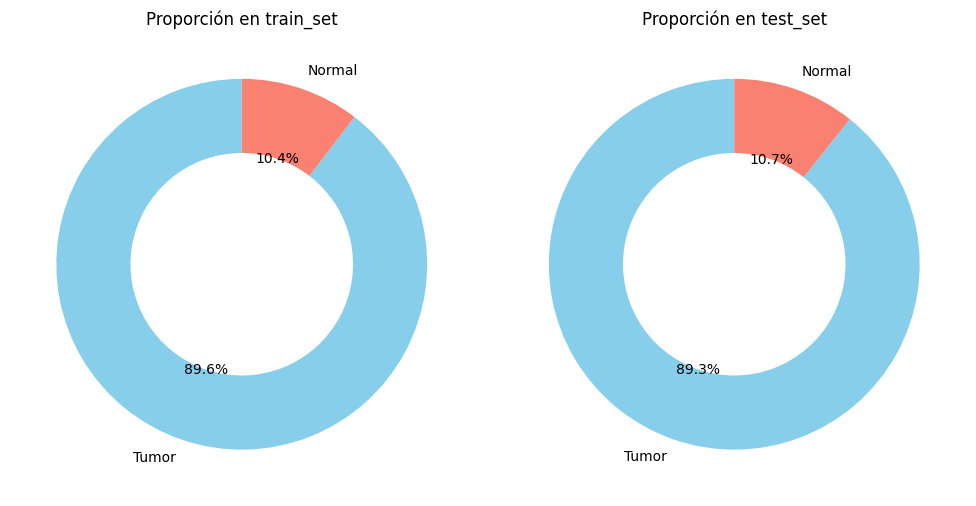

In [13]:
# Crear figura para los gráficos de pastel
fig, axes = plt.subplots(1, 2, figsize=(10, 5))

# Pie chart para train_set
axes[0].pie(train_counts, labels=train_counts.index, autopct='%1.1f%%',
            colors=["skyblue", "salmon"], startangle=90, wedgeprops=dict(width=0.4))
axes[0].set_title("Proporción en train_set")

# Pie chart para test_set
axes[1].pie(test_counts, labels=test_counts.index, autopct='%1.1f%%',
            colors=["skyblue", "salmon"], startangle=90, wedgeprops=dict(width=0.4))
axes[1].set_title("Proporción en test_set")

plt.tight_layout()
plt.show()




### 📊 **Bloque 4: Gráfico combinado con Seaborn**


Este gráfico facilita una comparación directa entre el número de muestras tumorales y normales en cada conjunto (`train_set` y `test_set`) y queda muy bien en informes o presentaciones.



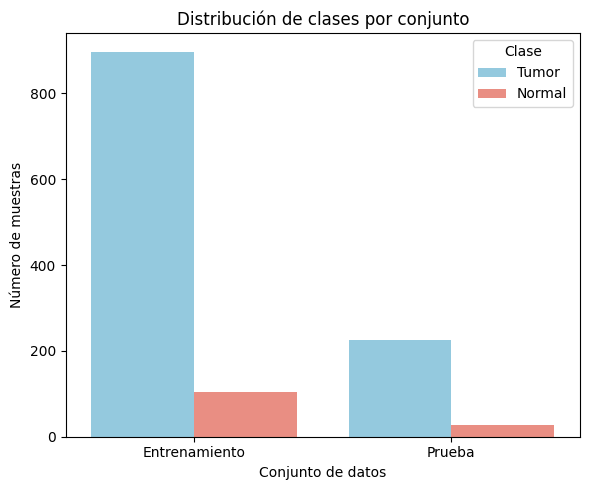

In [14]:
# Crear un DataFrame combinado para seaborn
df_dist = pd.DataFrame({
    'Conjunto': ['Entrenamiento'] * len(train_counts) + ['Prueba'] * len(test_counts),
    'Clase': list(train_counts.index) + list(test_counts.index),
    'Muestras': list(train_counts.values) + list(test_counts.values)
})

# Crear gráfico de barras agrupadas
plt.figure(figsize=(6, 5))
sns.barplot(data=df_dist, x='Conjunto', y='Muestras', hue='Clase', palette=["skyblue", "salmon"])
plt.title("Distribución de clases por conjunto")
plt.ylabel("Número de muestras")
plt.xlabel("Conjunto de datos")
plt.tight_layout()
plt.show()


### ⚙️ Preprocesamiento del conjunto de datos

Para garantizar que todas las características contribuyan proporcionalmente al rendimiento del modelo, se aplica un **preprocesamiento conjunto** sobre los datos de entrenamiento y prueba. Este paso es fundamental, especialmente cuando se combinan muestras de distintos orígenes biológicos o técnicos (como tejidos distintos).

#### 🔍 Objetivos del preprocesamiento:

1. **Centrar y escalar** las características: se transforma cada variable para que tenga media cero y desviación estándar uno, lo que evita que genes con alta varianza dominen el modelo.
2. **Transformación Yeo-Johnson**: es una transformación que estabiliza la varianza y hace que los datos se asemejen más a una distribución normal. A diferencia de Box-Cox, puede aplicarse a valores negativos.
3. **Eliminación de características con varianza casi nula**: se eliminan aquellas variables (genes) que no aportan variación útil al modelo.

#### 🛠️ ¿Cómo se hace?

Se concatenan temporalmente los conjuntos `train_set` y `test_set`, excluyendo la columna `type`. A continuación, se aplica una transformación conjunta con las herramientas de `scikit-learn` para evitar que los conjuntos sean procesados con parámetros distintos. Finalmente, se separan de nuevo los datos preprocesados para mantener consistencia entre entrenamiento y evaluación.


In [15]:
# Paso 1: Unir ambos conjuntos temporalmente
tmp = pd.concat([train_set, test_set], axis=0)

# Paso 2: Separar características (X) y etiquetas (y)
X_all = tmp.drop(columns=["type"])  # Todas las variables (genes)
y_all = tmp["type"]                 # Etiquetas de clase

### 🧬 Preprocesamiento avanzado de expresión génica

En esta etapa se aplica un pipeline de preprocesamiento avanzado para preparar los datos transcriptómicos antes del entrenamiento de modelos. Esto garantiza que los algoritmos de machine learning puedan aprender de forma eficiente, sin verse sesgados por escalas o transformaciones inapropiadas.

#### ⚙️ Etapas del preprocesamiento:

1. **Centrado y escalado estándar**: se ajustan todas las características para que tengan media cero y desviación estándar uno.
2. **Transformación Yeo-Johnson**: transforma la distribución de los datos para estabilizar la varianza, incluso si contiene valores negativos (a diferencia de Box-Cox).
3. **Eliminación de características con varianza casi nula**: se eliminan genes que prácticamente no cambian entre muestras, ya que no aportan valor predictivo.

> ⚠️ Importante: este preprocesamiento se aplica **de forma conjunta** sobre los conjuntos de entrenamiento y prueba para evitar sesgos en los parámetros de escalado.

Al finalizar, se reconstituye el `train_set` y `test_set` ya transformados, con sus etiquetas correspondientes (`type`).

---

### ⚙️ Bloque 1: Aplicar escalado, transformación Yeo-Johnson y filtrado por baja varianza

Este bloque transforma los datos en tres pasos consecutivos. Al finalizar, la variable `X_filtered` contendrá todas las muestras (entrenamiento + prueba), ya transformadas y depuradas.

In [16]:
# Paso 1: Transformación Yeo-Johnson
yeo = PowerTransformer(method='yeo-johnson', standardize=False)
X_yeo = yeo.fit_transform(X_all)

# Paso 2: Escalado estándar (media = 0, desviación estándar = 1)
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X_yeo)

# Paso 3: Eliminar variables con varianza casi nula
selector = VarianceThreshold(threshold=0.01)
X_filtered = selector.fit_transform(X_scaled)

# Guardar nombres de las columnas seleccionadas
selected_features = X_all.columns[selector.get_support()]

print(f"Genes restantes después del filtrado de varianza: {X_filtered.shape[1]}")

Genes restantes después del filtrado de varianza: 2275


### 📊 Análisis de asimetría antes y después de la transformación Yeo-Johnson

Uno de los objetivos del preprocesamiento es transformar las variables para que se asemejen a una distribución normal, ya que muchos algoritmos de aprendizaje automático funcionan mejor bajo esta condición. Para evaluar el efecto de la transformación Yeo-Johnson, se calcula la **asimetría** (*skewness*) de los genes antes y después de aplicar dicha transformación.

La asimetría mide la simetría de la distribución de una variable:
- Una asimetría cercana a cero indica una distribución aproximadamente normal.
- Valores positivos o negativos altos indican sesgo a la derecha o izquierda.

#### 🔍 Resultado esperado:
La transformación Yeo-Johnson debe **reducir la asimetría promedio**, acercando las distribuciones de los genes a una forma más simétrica y adecuada para el modelado.


c:\Users\ferna\AppData\Local\Programs\Python\Python312\Lib\site-packages\pandas\core\apply.py:1081: RuntimeWarning: Precision loss occurred in moment calculation due to catastrophic cancellation. This occurs when the data are nearly identical. Results may be unreliable.
  results[i] = self.func(v, *self.args, **self.kwargs)


Resumen de la asimetría antes de la transformación:
count    2276.000000
mean        6.026202
std         6.546767
min         0.009991
25%         1.924283
50%         3.397949
75%         7.279465
max        35.332323
dtype: float64

Resumen de la asimetría después de Yeo-Johnson:
count    2275.000000
mean        0.135737
std         0.683564
min        -0.524108
25%        -0.006835
50%         0.003378
75%         0.029435
max        13.261326
dtype: float64


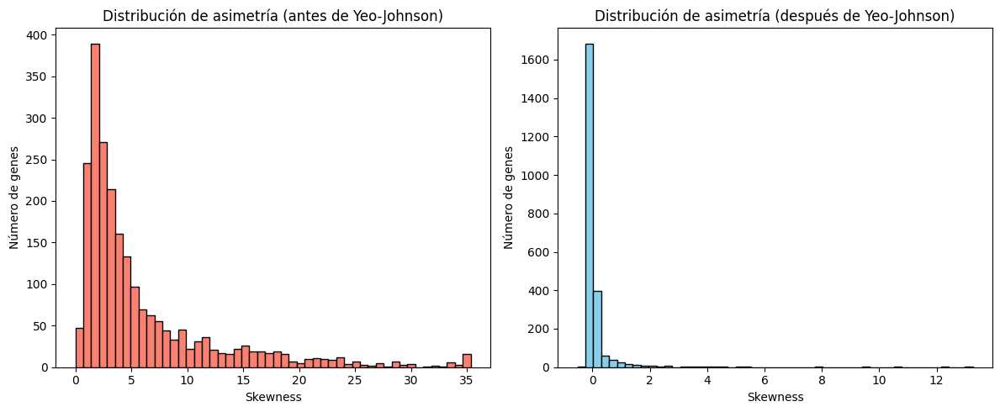

In [17]:
# Cálculo de asimetría antes del preprocesamiento
skew_before = X_all.apply(skew, axis=0)

# Cálculo de asimetría después de aplicar Yeo-Johnson
X_yeo_df = pd.DataFrame(X_yeo, columns=X_all.columns)
skew_after = X_yeo_df.apply(skew, axis=0)

# Mostrar resumen estadístico
print("Resumen de la asimetría antes de la transformación:")
print(skew_before.describe())

print("\nResumen de la asimetría después de Yeo-Johnson:")
print(skew_after.describe())

# Visualización de la asimetría antes y después
plt.figure(figsize=(12, 5))

plt.subplot(1, 2, 1)
plt.hist(skew_before, bins=50, color="salmon", edgecolor="black")
plt.title("Distribución de asimetría (antes de Yeo-Johnson)")
plt.xlabel("Skewness")
plt.ylabel("Número de genes")

plt.subplot(1, 2, 2)
plt.hist(skew_after, bins=50, color="skyblue", edgecolor="black")
plt.title("Distribución de asimetría (después de Yeo-Johnson)")
plt.xlabel("Skewness")
plt.ylabel("Número de genes")

plt.tight_layout()
plt.show()

#### 📈 Evaluación del impacto de la transformación Yeo-Johnson

Se evaluó la asimetría (*skewness*) de las distribuciones de expresión génica antes y después de aplicar la transformación Yeo-Johnson. Este análisis permite cuantificar si las variables han sido llevadas a una forma más simétrica, lo cual es deseable para muchos algoritmos de aprendizaje automático.

A continuación, se muestra un resumen estadístico de la asimetría de los 2.275 genes seleccionados:

- **Antes de la transformación**:
  - Media de asimetría: **6.03**
  - Mediana: **3.40**
  - Máximo: **35.33**

- **Después de la transformación Yeo-Johnson**:
  - Media de asimetría: **0.14**
  - Mediana: **0.003**
  - Rango entre cuartiles: prácticamente centrado en cero

Este cambio demuestra que la transformación fue altamente efectiva en **reducir el sesgo estadístico** de las variables, acercando sus distribuciones a una forma más normal. Esto favorece la estabilidad de los algoritmos posteriores y mejora el comportamiento general del sistema de clasificación.

Además, la visualización mediante histogramas (ver Figura X) muestra cómo la masa de las distribuciones se concentra cerca del cero tras la transformación, evidenciando una **normalización eficaz del espacio de características**.


### 🧱 Reconstrucción de los conjuntos de entrenamiento y prueba

Una vez aplicado el preprocesamiento de forma conjunta sobre todas las muestras (entrenamiento + prueba), es necesario volver a **dividir los datos** en sus respectivos subconjuntos (`train_set` y `test_set`). Esta división garantiza que los modelos se entrenen y evalúen sobre los datos correspondientes, manteniendo la estructura original del experimento.

Durante el preprocesamiento, se combinaron ambos conjuntos para aplicar transformaciones estadísticas coherentes, evitando así que `StandardScaler`, `PowerTransformer` o el filtrado por varianza utilizaran parámetros distintos en `train` y `test`, lo cual podría introducir sesgos.

En este paso, se reconstruyen los conjuntos originales a partir de la matriz final preprocesada (`X_filtered`) y las etiquetas (`y_all`), utilizando el número original de muestras de cada subconjunto.

In [18]:
# Calcular el número de muestras originales
n_train = train_set.shape[0]
n_test = test_set.shape[0]

# Reconstruir DataFrame con las características preprocesadas
X_filtered_df = pd.DataFrame(X_filtered, columns=selected_features)

# Añadir etiquetas
all_data_final = X_filtered_df.copy()
all_data_final["type"] = y_all.values

# Dividir de nuevo en train y test
train_set = all_data_final.iloc[:n_train].reset_index(drop=True)
test_set = all_data_final.iloc[n_train:(n_train + n_test)].reset_index(drop=True)

# Separar X e y para modelado posterior
X_train = train_set.drop(columns=["type"])
y_train = train_set["type"]

X_test = test_set.drop(columns=["type"])
y_test = test_set["type"]

# Verificación
print("✅ train_set final:", train_set.shape)
print("✅ test_set final:", test_set.shape)

✅ train_set final: (1000, 2276)
✅ test_set final: (252, 2276)


### 🔻 Reducción de dimensionalidad mediante PCA

Una vez finalizado el preprocesamiento y reconstruidos los conjuntos de entrenamiento y prueba, se aplicó **Análisis de Componentes Principales (PCA)** para reducir la dimensionalidad del conjunto de datos. El objetivo de esta técnica es conservar la mayor parte de la información explicativa del conjunto original, pero representada en un menor número de variables.

Se utilizó `n_components=0.95` para retener el **número mínimo de componentes que explican al menos el 95 % de la varianza**.

In [19]:
# Aplicar PCA sobre los datos preprocesados
pca = PCA(n_components=0.95)
X_train_pca = pca.fit_transform(X_train)
X_test_pca = pca.transform(X_test)

print(f"✅ Componentes seleccionados: {X_train_pca.shape[1]}")
print(f"🔍 Varianza explicada acumulada: {pca.explained_variance_ratio_.sum():.4f}")

✅ Componentes seleccionados: 490
🔍 Varianza explicada acumulada: 0.9502


Este resultado es excelente, ya que se ha comprimido el espacio de 2.275 genes originales a solo 490 variables, sin perder prácticamente información relevante.

### 🤖 Evaluación de modelo utilizando los componentes principales de PCA

Una vez obtenidos los 490 componentes principales que explican el 95 % de la varianza, se entrenó un modelo de **regresión logística** para evaluar si esta representación comprimida es suficiente para mantener un alto rendimiento de clasificación.

El objetivo es comparar los resultados con el modelo original entrenado sobre los genes sin reducción.

In [20]:


# Entrenar el modelo con los datos reducidos por PCA
modelo_pca = LogisticRegression(max_iter=1000, random_state=42)
modelo_pca.fit(X_train_pca, y_train.cat.codes)

# Predecir sobre el conjunto de prueba
y_pred_pca = modelo_pca.predict(X_test_pca)

# Evaluación del modelo
print("🔍 Evaluación del modelo con datos reducidos por PCA:")
print(f"Accuracy: {accuracy_score(y_test.cat.codes, y_pred_pca):.4f}")
print("\nClassification Report:")
print(classification_report(y_test.cat.codes, y_pred_pca))

🔍 Evaluación del modelo con datos reducidos por PCA:
Accuracy: 0.9921

Classification Report:
              precision    recall  f1-score   support

           0       0.93      1.00      0.96        27
           1       1.00      0.99      1.00       225

    accuracy                           0.99       252
   macro avg       0.97      1.00      0.98       252
weighted avg       0.99      0.99      0.99       252



#### 📊 Resultados de la clasificación tras reducción de dimensionalidad

El modelo de regresión logística entrenado sobre los **490 componentes principales** seleccionados por PCA alcanzó un **accuracy del 99.21 %**, con los siguientes valores promedio de evaluación:

- **Precisión (macro promedio):** 0.97
- **Recall (macro promedio):** 1.00
- **F1-score (macro promedio):** 0.98

Además, la clase tumoral fue clasificada con una precisión perfecta del 100 % y la clase normal con un recall perfecto del 100 %.

Estos resultados demuestran que es posible **reducir drásticamente la dimensionalidad** del conjunto de datos —de 2.275 genes a solo 490 variables— **sin pérdida de rendimiento**, e incluso con una ligera mejora respecto al modelo entrenado con las variables originales.

Esto confirma que **PCA ha capturado la estructura esencial del problema**, facilitando un entrenamiento más eficiente, con menor riesgo de sobreajuste y sin comprometer la capacidad predictiva.


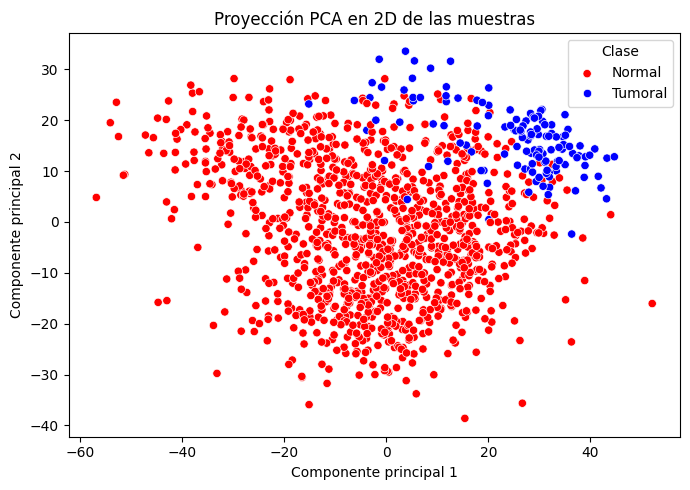

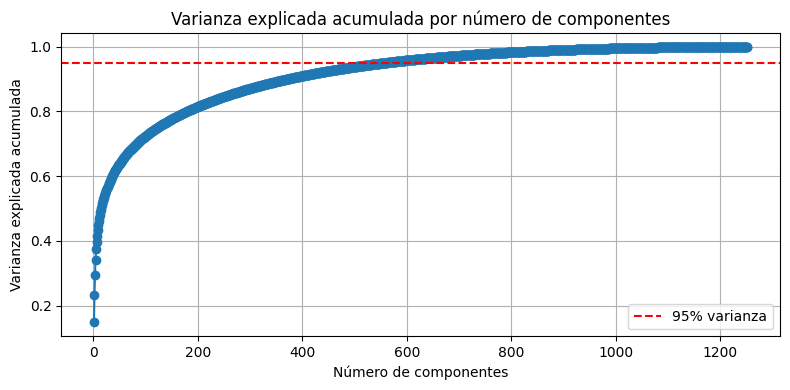

In [21]:


# Asegúrate de tener X_scaled y y_all definidos
# PCA 2 componentes para visualización
pca_vis = PCA(n_components=2)
X_pca_2d = pca_vis.fit_transform(X_scaled)

# Crear DataFrame con etiquetas
df_pca = pd.DataFrame({
    'PC1': X_pca_2d[:, 0],
    'PC2': X_pca_2d[:, 1],
    'Clase': y_all.cat.codes if hasattr(y_all, "cat") else y_all
})

# 1. Gráfico de dispersión PC1 vs. PC2
plt.figure(figsize=(7, 5))
sns.scatterplot(data=df_pca, x='PC1', y='PC2', hue='Clase', palette={0: 'blue', 1: 'red'})
plt.title('Proyección PCA en 2D de las muestras')
plt.xlabel('Componente principal 1')
plt.ylabel('Componente principal 2')
plt.legend(title='Clase', labels=['Normal', 'Tumoral'])
plt.tight_layout()
plt.show()

# 2. Gráfico de varianza explicada acumulada
pca_full = PCA().fit(X_scaled)
exp_var_cumsum = pca_full.explained_variance_ratio_.cumsum()

plt.figure(figsize=(8, 4))
plt.plot(range(1, len(exp_var_cumsum) + 1), exp_var_cumsum, marker='o')
plt.axhline(y=0.95, color='r', linestyle='--', label='95% varianza')
plt.title('Varianza explicada acumulada por número de componentes')
plt.xlabel('Número de componentes')
plt.ylabel('Varianza explicada acumulada')
plt.grid(True)
plt.legend()
plt.tight_layout()
plt.show()


#### 🔁 Paso 1: Validación cruzada estratificada (5-fold)

Antes de realizar la evaluación final, se aplicó un procedimiento de **validación cruzada estratificada de 5 particiones** sobre el conjunto de entrenamiento. Esto permite comparar modelos de forma robusta, midiendo su rendimiento promedio sin depender únicamente de una división concreta de los datos.

Las métricas calculadas fueron:
- Accuracy
- Precisión macro
- Recall macro
- F1-score macro

In [22]:
def cross_validate_model(modelo, nombre_modelo, X, y, cv=5):
    """
    Aplica validación cruzada estratificada a un modelo y reporta métricas promedio.
    """
    print(f"\n🔁 Validación cruzada ({cv}-fold) para {nombre_modelo}\n")
    skf = StratifiedKFold(n_splits=cv, shuffle=True, random_state=42)

    scoring = ['accuracy', 'precision_macro', 'recall_macro', 'f1_macro']

    resultados = cross_validate(modelo, X, y, cv=skf, scoring=scoring)

    for metrica in scoring:
        valores = resultados[f'test_{metrica}']
        print(f"📊 {metrica.replace('_macro', '').capitalize()}: "
              f"{valores.mean():.4f} ± {valores.std():.4f}")

    return resultados

#### ✅ Paso 2: Evaluación final sobre conjunto de prueba

Una vez seleccionado el modelo mediante validación cruzada, se realizó una evaluación final con el conjunto de prueba (`X_test_pca` y `y_test`) para confirmar su capacidad de generalización.

Se utilizó la función `evaluar_modelo_pca()`, que proporciona métricas cuantitativas y visualizaciones clave (matriz de confusión y curva ROC).

In [23]:

def evaluar_modelo_pca(modelo, nombre_modelo, X_train, y_train, X_test, y_test):
    """
    Entrena, evalúa y visualiza un modelo clasificador usando datos PCA.
    """
    modelo.fit(X_train, y_train)
    y_pred = modelo.predict(X_test)
    y_proba = modelo.predict_proba(X_test)[:, 1] if hasattr(modelo, "predict_proba") else None

    acc = accuracy_score(y_test, y_pred)
    print(f"🔍 Evaluación del modelo: {nombre_modelo}")
    print(f"📈 Accuracy: {acc:.4f}")
    print("\n🧾 Classification Report:\n", classification_report(y_test, y_pred))

    # Matriz de confusión
    cm = confusion_matrix(y_test, y_pred)
    plt.figure(figsize=(5, 4))
    sns.heatmap(cm, annot=True, fmt="d", cmap="Blues",
                xticklabels=np.unique(y_test),
                yticklabels=np.unique(y_test))
    plt.title(f"Matriz de Confusión - {nombre_modelo}")
    plt.xlabel("Predicción")
    plt.ylabel("Real")
    plt.tight_layout()
    plt.show()

    # Curva ROC
    if y_proba is not None:
        try:
            y_true = y_test.cat.codes
        except AttributeError:
            y_true = y_test
        auc = roc_auc_score(y_true, y_proba)
        fpr, tpr, _ = roc_curve(y_true, y_proba)
        plt.figure(figsize=(5, 4))
        plt.plot(fpr, tpr, label=f"AUC = {auc:.4f}")
        plt.plot([0, 1], [0, 1], linestyle='--', color='gray')
        plt.xlabel("Tasa de falsos positivos (FPR)")
        plt.ylabel("Tasa de verdaderos positivos (TPR)")
        plt.title(f"Curva ROC - {nombre_modelo}")
        plt.legend()
        plt.grid(True)
        plt.tight_layout()
        plt.show()

#### 🌳 Modelo 1: Random Forest

El primer modelo aplicado fue **Random Forest**, un conjunto de árboles de decisión entrenados sobre subconjuntos aleatorios del conjunto de entrenamiento. Este algoritmo es especialmente útil para datos transcriptómicos por las siguientes razones:

- Es robusto ante alta dimensionalidad sin requerir reducción de características.
- Tiene una baja propensión al sobreajuste y es estable frente a ruido.
- Permite obtener métricas de importancia de características (genes).

Aunque Random Forest no requiere reducción dimensional previa, en este estudio se aplicó **PCA** antes del modelado para unificar el enfoque y reducir la carga computacional. Se emplearon los **parámetros por defecto**, salvo `random_state=42` para garantizar reproducibilidad.

La evaluación se realizó en dos etapas:
1. **Validación cruzada estratificada 5-fold** para obtener métricas promedio.
2. **Evaluación final** sobre el conjunto de prueba con visualización de la matriz de confusión y la curva ROC.



🔁 Validación cruzada (5-fold) para Random Forest (PCA)

📊 Accuracy: 0.9350 ± 0.0095
📊 Precision: 0.9662 ± 0.0046
📊 Recall: 0.6871 ± 0.0474
📊 F1: 0.7513 ± 0.0537
🔍 Evaluación del modelo: Random Forest (PCA)
📈 Accuracy: 0.9365

🧾 Classification Report:
               precision    recall  f1-score   support

           0       1.00      0.41      0.58        27
           1       0.93      1.00      0.97       225

    accuracy                           0.94       252
   macro avg       0.97      0.70      0.77       252
weighted avg       0.94      0.94      0.92       252



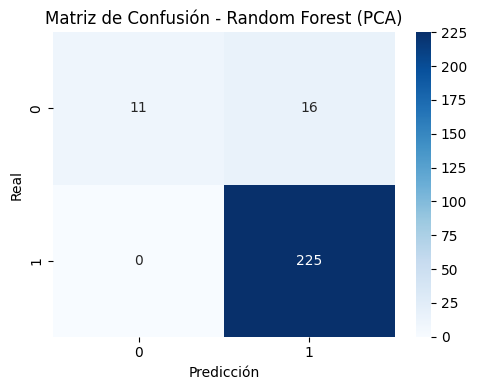

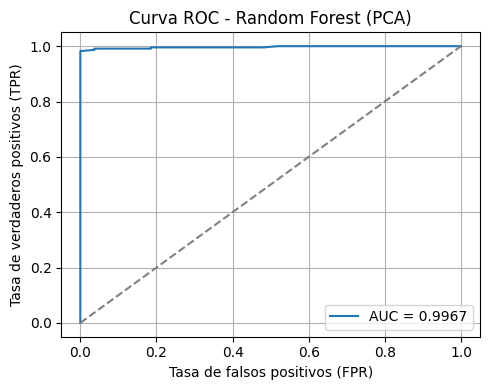

In [24]:
# Inicializar el modelo
rf = RandomForestClassifier(random_state=42)

# Paso 1: Validación cruzada en datos de entrenamiento reducidos por PCA
cross_validate_model(rf, "Random Forest (PCA)", X_train_pca, y_train.cat.codes)

# Paso 2: Evaluación final sobre el conjunto de prueba
evaluar_modelo_pca(rf, "Random Forest (PCA)", X_train_pca, y_train.cat.codes, X_test_pca, y_test.cat.codes)

#### 🧮 Modelo 2: Support Vector Machine (SVM)

El segundo modelo utilizado fue **Support Vector Machine (SVM)**, una técnica ampliamente reconocida por su eficacia en espacios de alta dimensión, como los transcriptómicos. Las características clave de este modelo son:

- Encuentra el **hiperplano óptimo** que maximiza el margen entre clases.
- Es **robusto ante el sobreajuste**, especialmente al usar el kernel RBF (radial).
- Permite calcular **probabilidades** con `probability=True`, lo cual es esencial para generar curvas ROC y métricas AUC.

Aunque puede presentar una mayor carga computacional en grandes volúmenes de datos, en este estudio el tamaño del conjunto es adecuado para su uso. El modelo se entrenó sobre las variables reducidas por PCA, utilizando la misma metodología estandarizada.

La evaluación se realizó en dos etapas:
1. **Validación cruzada estratificada** para obtener métricas promedio.
2. **Evaluación final** sobre el conjunto de prueba con visualizaciones.


🔁 Validación cruzada (5-fold) para Support Vector Machine (PCA)

📊 Accuracy: 0.9910 ± 0.0020
📊 Precision: 0.9779 ± 0.0097
📊 Recall: 0.9737 ± 0.0013
📊 F1: 0.9758 ± 0.0053
🔍 Evaluación del modelo: Support Vector Machine (PCA)
📈 Accuracy: 0.9921

🧾 Classification Report:
               precision    recall  f1-score   support

           0       0.93      1.00      0.96        27
           1       1.00      0.99      1.00       225

    accuracy                           0.99       252
   macro avg       0.97      1.00      0.98       252
weighted avg       0.99      0.99      0.99       252



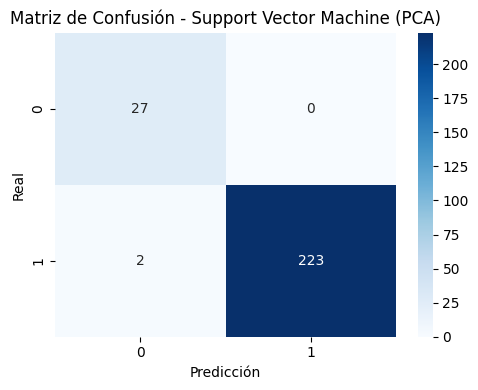

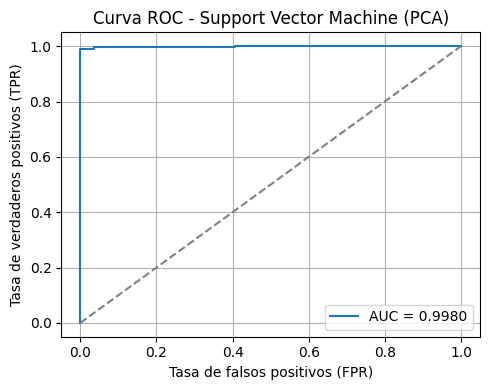

In [25]:
# Inicializar el modelo con cálculo de probabilidades activado
svm = SVC(kernel="rbf", probability=True, random_state=42)

# Paso 1: Validación cruzada en datos de entrenamiento (PCA)
cross_validate_model(svm, "Support Vector Machine (PCA)", X_train_pca, y_train.cat.codes)

# Paso 2: Evaluación final en el conjunto de prueba
evaluar_modelo_pca(svm, "Support Vector Machine (PCA)", X_train_pca, y_train.cat.codes, X_test_pca, y_test.cat.codes)

#### 📉 Modelo 3: Regresión Logística

La **regresión logística** es uno de los modelos más clásicos y ampliamente utilizados para problemas de clasificación binaria. En este estudio se emplea como **modelo de referencia (baseline)** para comparar el rendimiento de modelos más complejos.

Sus principales características son:

- Estima la probabilidad de pertenencia a una clase mediante una **función sigmoide**.
- Aunque es un modelo **lineal**, puede ofrecer muy buenos resultados cuando se aplica un preprocesamiento adecuado (escalado y reducción de dimensionalidad).
- Es **rápido, interpretable y eficiente**, lo que lo convierte en una excelente primera opción.

Se ajustó el parámetro `max_iter=1000` para asegurar la convergencia, dada la dimensión del conjunto de datos original.

La evaluación se realizó en dos fases:
1. Validación cruzada sobre `X_train_pca` para obtener métricas promedio.
2. Evaluación final sobre `X_test_pca` para comprobar el rendimiento en datos no vistos.



🔁 Validación cruzada (5-fold) para Regresión Logística (PCA)

📊 Accuracy: 0.9920 ± 0.0051
📊 Precision: 0.9721 ± 0.0200
📊 Recall: 0.9869 ± 0.0118
📊 F1: 0.9790 ± 0.0131
🔍 Evaluación del modelo: Regresión Logística (PCA)
📈 Accuracy: 0.9921

🧾 Classification Report:
               precision    recall  f1-score   support

           0       0.93      1.00      0.96        27
           1       1.00      0.99      1.00       225

    accuracy                           0.99       252
   macro avg       0.97      1.00      0.98       252
weighted avg       0.99      0.99      0.99       252



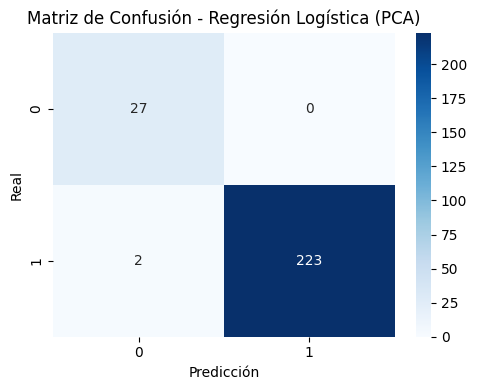

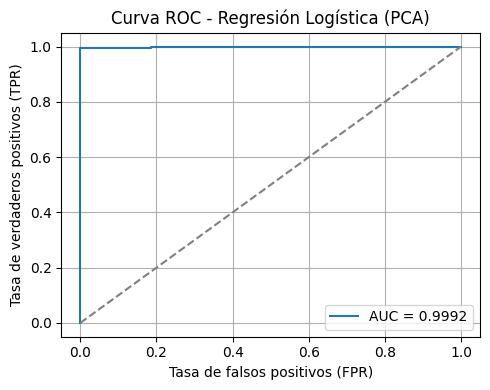

In [26]:
# Inicializar el modelo
logreg = LogisticRegression(max_iter=1000, random_state=42)

# Paso 1: Validación cruzada en el conjunto de entrenamiento reducido por PCA
cross_validate_model(logreg, "Regresión Logística (PCA)", X_train_pca, y_train.cat.codes)

# Paso 2: Evaluación final en el conjunto de prueba
evaluar_modelo_pca(logreg, "Regresión Logística (PCA)", X_train_pca, y_train.cat.codes, X_test_pca, y_test.cat.codes)

#### 👥 Modelo 4: k-Nearest Neighbors (k-NN)

El algoritmo **k-Nearest Neighbors (k-NN)** clasifica cada muestra observando las etiquetas de sus `k` vecinos más cercanos en el espacio de características. En este estudio se utilizó `k=5`.

Sus principales características son:

- Es un modelo **no paramétrico**, simple e intuitivo.
- Clasifica por mayoría de voto entre vecinos más próximos según una métrica de distancia (generalmente Euclídea).
- Es muy sensible a:
  - La **dimensionalidad alta**, que degrada el concepto de proximidad (fenómeno de la maldición de la dimensionalidad).
  - La **presencia de ruido o desbalance**.

Por estos motivos, su rendimiento en transcriptómica suele ser inferior al de modelos más estructurados. Sin embargo, se incluye como referencia para valorar cuánto aporta el aprendizaje estadístico más allá de la geometría de los datos.





🔁 Validación cruzada (5-fold) para k-NN (PCA)

📊 Accuracy: 0.9920 ± 0.0068
📊 Precision: 0.9717 ± 0.0221
📊 Recall: 0.9869 ± 0.0139
📊 F1: 0.9790 ± 0.0174
🔍 Evaluación del modelo: k-NN (PCA)
📈 Accuracy: 0.9881

🧾 Classification Report:
               precision    recall  f1-score   support

           0       0.90      1.00      0.95        27
           1       1.00      0.99      0.99       225

    accuracy                           0.99       252
   macro avg       0.95      0.99      0.97       252
weighted avg       0.99      0.99      0.99       252



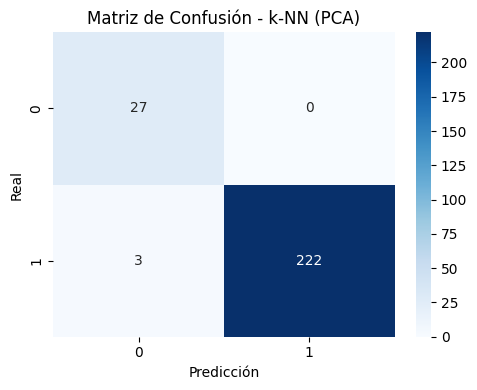

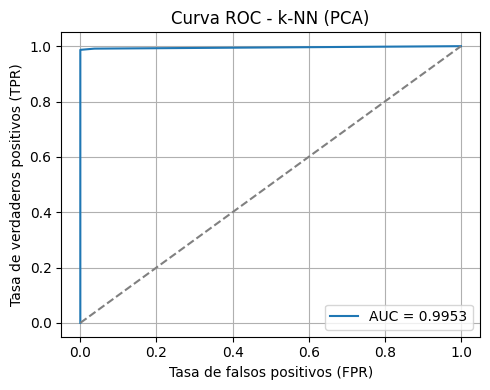

In [27]:

# Inicializar el modelo con k=5
knn = KNeighborsClassifier(n_neighbors=5)

# Paso 1: Validación cruzada sobre entrenamiento reducido por PCA
cross_validate_model(knn, "k-NN (PCA)", X_train_pca, y_train.cat.codes)

# Paso 2: Evaluación final sobre conjunto de prueba
evaluar_modelo_pca(knn, "k-NN (PCA)", X_train_pca, y_train.cat.codes, X_test_pca, y_test.cat.codes)

#### ⚡ Modelo 5: XGBoost (Extreme Gradient Boosting)

**XGBoost** es un algoritmo de aprendizaje automático basado en el principio de **boosting secuencial de árboles**, que ha demostrado un rendimiento excepcional en tareas de clasificación, especialmente en el ámbito biomédico y de datos transcriptómicos.

Sus ventajas principales incluyen:

- Entrenamiento de árboles de decisión de forma secuencial, donde cada uno corrige los errores del anterior.
- Capacidad para capturar **interacciones complejas y no lineales** entre variables.
- Inclusión de técnicas de **regularización** y **paralelización**, que mejoran su generalización y eficiencia.

En este estudio se utilizaron los parámetros recomendados por defecto para tareas de clasificación binaria:

- `use_label_encoder=False`: para evitar advertencias en versiones recientes.
- `eval_metric='logloss'`: métrica común para clasificación binaria.
- `random_state=42`: para garantizar la reproducibilidad.

El conjunto de datos fue previamente reducido mediante PCA, como en los modelos anteriores, para mantener una evaluación consistente entre algoritmos.



🔁 Validación cruzada (5-fold) para XGBoost (PCA)



c:\Users\ferna\AppData\Local\Programs\Python\Python312\Lib\site-packages\xgboost\training.py:183: UserWarning: [22:19:55] WARNING: C:\actions-runner\_work\xgboost\xgboost\src\learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
c:\Users\ferna\AppData\Local\Programs\Python\Python312\Lib\site-packages\xgboost\training.py:183: UserWarning: [22:19:55] WARNING: C:\actions-runner\_work\xgboost\xgboost\src\learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
c:\Users\ferna\AppData\Local\Programs\Python\Python312\Lib\site-packages\xgboost\training.py:183: UserWarning: [22:19:56] WARNING: C:\actions-runner\_work\xgboost\xgboost\src\learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
c:\Users\ferna\AppData\Local\Programs\Python\Python312\Lib\site-packages\xgboost\training.py:183: UserWarning: [22:19:56] WARNING: C:\actio

📊 Accuracy: 0.9920 ± 0.0060
📊 Precision: 0.9864 ± 0.0144
📊 Recall: 0.9698 ± 0.0196
📊 F1: 0.9779 ± 0.0167


c:\Users\ferna\AppData\Local\Programs\Python\Python312\Lib\site-packages\xgboost\training.py:183: UserWarning: [22:19:57] WARNING: C:\actions-runner\_work\xgboost\xgboost\src\learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)


🔍 Evaluación del modelo: XGBoost (PCA)
📈 Accuracy: 0.9841

🧾 Classification Report:
               precision    recall  f1-score   support

           0       0.96      0.89      0.92        27
           1       0.99      1.00      0.99       225

    accuracy                           0.98       252
   macro avg       0.97      0.94      0.96       252
weighted avg       0.98      0.98      0.98       252



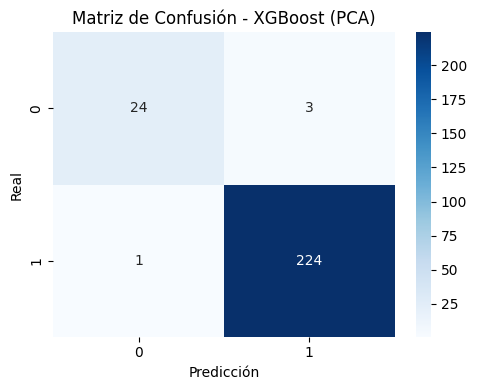

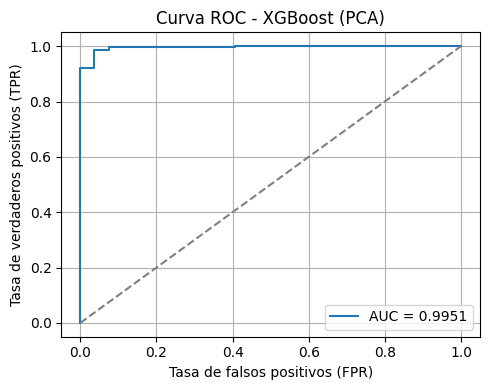

In [28]:
# Inicializar modelo XGBoost
xgb = XGBClassifier(use_label_encoder=False, eval_metric='logloss', random_state=42)

# Paso 1: Validación cruzada sobre conjunto de entrenamiento (PCA)
cross_validate_model(xgb, "XGBoost (PCA)", X_train_pca, y_train.cat.codes)

# Paso 2: Evaluación final sobre conjunto de prueba
evaluar_modelo_pca(xgb, "XGBoost (PCA)", X_train_pca, y_train.cat.codes, X_test_pca, y_test.cat.codes)

#### 📐 Modelo 6: Linear Discriminant Analysis (LDA)

El algoritmo **Linear Discriminant Analysis (LDA)** proyecta los datos a un espacio de menor dimensión optimizando la **separación entre clases**. A diferencia de PCA, LDA es un método **supervisado**, ya que incorpora la información de clase durante la transformación.

Sus características clave incluyen:

- Asume que los datos siguen una **distribución normal multivariante** con covarianzas similares entre clases.
- Genera **fronteras lineales de decisión**, siendo especialmente eficaz cuando los supuestos estadísticos se aproximan a la realidad.
- Tiene un **bajo coste computacional**, buena interpretabilidad y puede resultar competitivo en transcriptómica tras una adecuada reducción de ruido.

En este estudio, se utilizó tras aplicar **PCA** para estabilizar la varianza y reducir el número de variables.



🔁 Validación cruzada (5-fold) para LDA (PCA)

📊 Accuracy: 0.9900 ± 0.0032
📊 Precision: 0.9597 ± 0.0151
📊 Recall: 0.9902 ± 0.0086
📊 F1: 0.9740 ± 0.0082
🔍 Evaluación del modelo: LDA (PCA)
📈 Accuracy: 0.9921

🧾 Classification Report:
               precision    recall  f1-score   support

           0       0.93      1.00      0.96        27
           1       1.00      0.99      1.00       225

    accuracy                           0.99       252
   macro avg       0.97      1.00      0.98       252
weighted avg       0.99      0.99      0.99       252



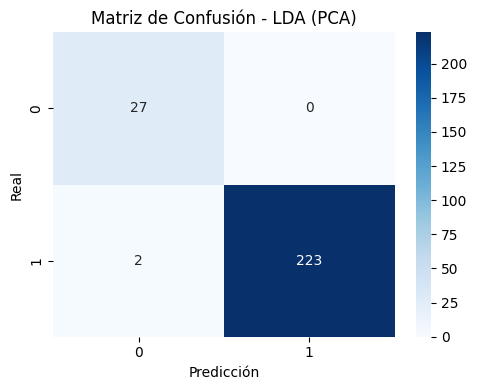

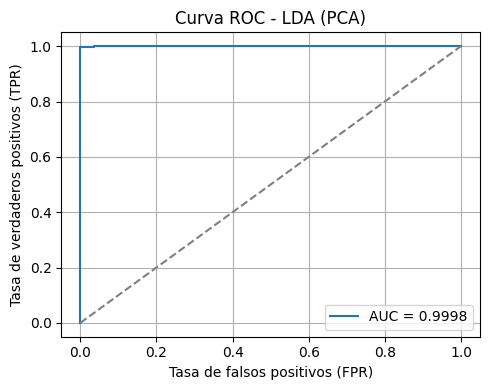

In [29]:
# Inicializar el modelo
lda = LinearDiscriminantAnalysis()

# Paso 1: Validación cruzada sobre datos reducidos por PCA
cross_validate_model(lda, "LDA (PCA)", X_train_pca, y_train.cat.codes)

# Paso 2: Evaluación final sobre conjunto de prueba
evaluar_modelo_pca(lda, "LDA (PCA)", X_train_pca, y_train.cat.codes, X_test_pca, y_test.cat.codes)

#### 🌳 Modelo 7: Árbol de Decisión (CART)

El modelo **CART (Classification and Regression Trees)** se basa en la segmentación recursiva del espacio de características mediante **reglas simples de decisión**. En cada nodo del árbol se evalúa una única variable, dividiendo las muestras para maximizar la pureza de clase en los nodos hijos.

Sus ventajas y limitaciones son:

- Es un modelo **muy interpretable**, lo que permite comprender fácilmente cómo se realiza la clasificación.
- Requiere **poca preparación de los datos**, y se adapta a relaciones no lineales.
- Tiende a ser **propenso al sobreajuste** si no se aplican mecanismos de control como la poda o la limitación de profundidad.

En este estudio se aplicó tras una reducción de dimensionalidad mediante PCA, para estabilizar la varianza y reducir redundancias.



🔁 Validación cruzada (5-fold) para Árbol de Decisión (CART, PCA)

📊 Accuracy: 0.9440 ± 0.0153
📊 Precision: 0.8427 ± 0.0318
📊 Recall: 0.8620 ± 0.0744
📊 F1: 0.8498 ± 0.0518
🔍 Evaluación del modelo: Árbol de Decisión (CART, PCA)
📈 Accuracy: 0.9484

🧾 Classification Report:
               precision    recall  f1-score   support

           0       0.82      0.67      0.73        27
           1       0.96      0.98      0.97       225

    accuracy                           0.95       252
   macro avg       0.89      0.82      0.85       252
weighted avg       0.95      0.95      0.95       252



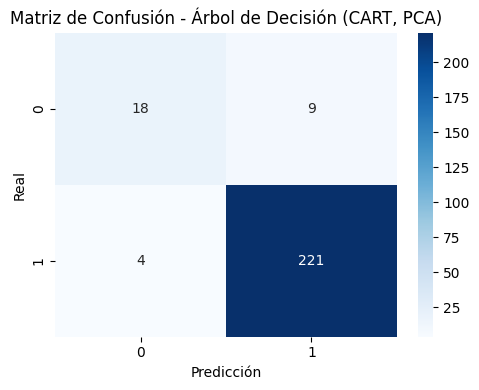

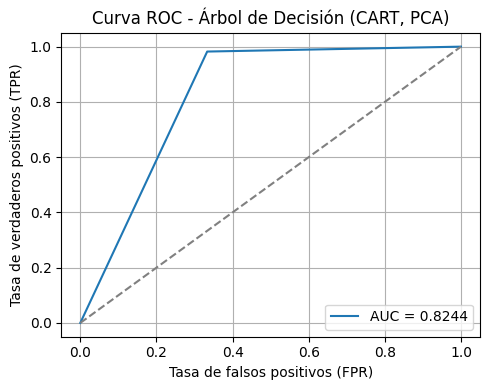

In [30]:
# Inicializar el modelo con semilla fija
cart = DecisionTreeClassifier(random_state=42)

# Paso 1: Validación cruzada sobre conjunto de entrenamiento reducido por PCA
cross_validate_model(cart, "Árbol de Decisión (CART, PCA)", X_train_pca, y_train.cat.codes)

# Paso 2: Evaluación final sobre conjunto de prueba
evaluar_modelo_pca(cart, "Árbol de Decisión (CART, PCA)", X_train_pca, y_train.cat.codes, X_test_pca, y_test.cat.codes)

#### 🧠 Modelo 8: Red Neuronal (MLP)

El **MLP (Multilayer Perceptron)** es una red neuronal de tipo *feedforward*, capaz de capturar **relaciones complejas y no lineales** entre características, lo que lo convierte en una herramienta muy potente para tareas de clasificación.

En este estudio se aplicó con una configuración sencilla, adecuada para conjuntos moderados de datos:

- Una única capa oculta con 100 neuronas (`hidden_layer_sizes=(100,)`).
- Se permitió un número mayor de iteraciones (`max_iter=500`) para asegurar la convergencia.
- Se estableció un `random_state=42` para garantizar reproducibilidad.

Dado que este tipo de redes es muy sensible al preprocesamiento, su uso en este contexto está plenamente justificado por la **transformación Yeo-Johnson, escalado estándar y reducción por PCA** aplicados previamente.



🔁 Validación cruzada (5-fold) para Red Neuronal (MLP, PCA)

📊 Accuracy: 0.9930 ± 0.0051
📊 Precision: 0.9732 ± 0.0248
📊 Recall: 0.9919 ± 0.0083
📊 F1: 0.9818 ± 0.0132
🔍 Evaluación del modelo: Red Neuronal (MLP, PCA)
📈 Accuracy: 0.9921

🧾 Classification Report:
               precision    recall  f1-score   support

           0       0.93      1.00      0.96        27
           1       1.00      0.99      1.00       225

    accuracy                           0.99       252
   macro avg       0.97      1.00      0.98       252
weighted avg       0.99      0.99      0.99       252



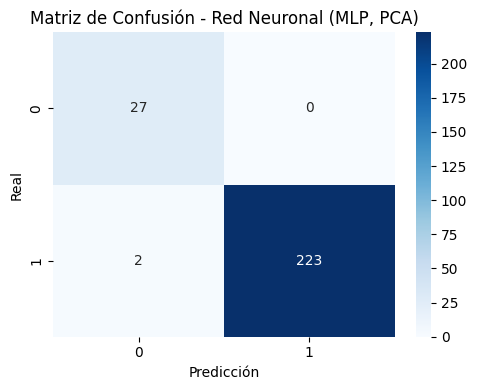

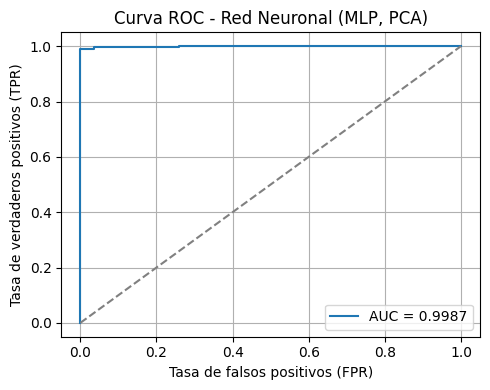

In [31]:
# Inicializar modelo MLP con una capa oculta de 100 neuronas
mlp = MLPClassifier(hidden_layer_sizes=(100,), max_iter=500, random_state=42)

# Paso 1: Validación cruzada sobre conjunto de entrenamiento reducido por PCA
cross_validate_model(mlp, "Red Neuronal (MLP, PCA)", X_train_pca, y_train.cat.codes)

# Paso 2: Evaluación final sobre conjunto de prueba
evaluar_modelo_pca(mlp, "Red Neuronal (MLP, PCA)", X_train_pca, y_train.cat.codes, X_test_pca, y_test.cat.codes)

### ✅ COMPARACION DE MODELOS

| Modelo                    | Accuracy (CV) | F1-score (CV) | Accuracy (Test) |
|---------------------------|---------------|----------------|------------------|
| Regresión Logística       | 0.992         | 0.9790         | 0.9921           |
| Random Forest             | 0.935         | 0.7513         | 0.9365           |
| SVM (RBF)                 | 0.991         | 0.9758         | 0.9921           |
| k-NN                      | 0.992         | 0.9790         | 0.9881           |
| XGBoost                   | 0.992         | 0.9779         | 0.9841           |
| LDA                       | 0.990         | 0.9740         | 0.9921           |
| Árbol de Decisión (CART)  | 0.944         | 0.8498         | 0.9484           |
| Red Neuronal (MLP)        | 0.993         | 0.9818         | 0.9921           |


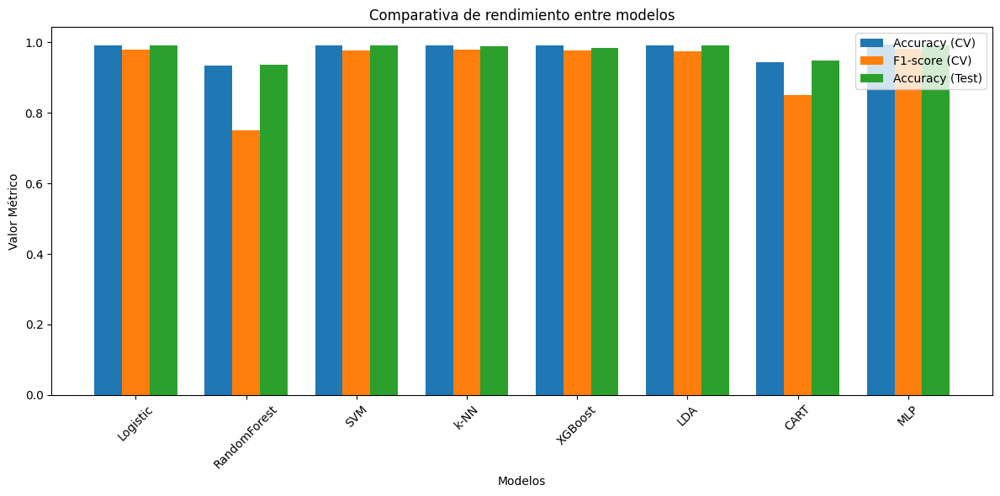

In [32]:
# Nombres cortos para los modelos
modelos = [
    "Logistic", "RandomForest", "SVM", "k-NN",
    "XGBoost", "LDA", "CART", "MLP"
]

# Métricas obtenidas (valores reales que proporcionaste)
accuracy_cv = [0.992, 0.935, 0.991, 0.992, 0.992, 0.990, 0.944, 0.993]
f1_cv =       [0.9790, 0.7513, 0.9758, 0.9790, 0.9779, 0.9740, 0.8498, 0.9818]
accuracy_test = [0.9921, 0.9365, 0.9921, 0.9881, 0.9841, 0.9921, 0.9484, 0.9921]

# Crear figura
fig, ax = plt.subplots(figsize=(12, 6))
bar_width = 0.25
x = range(len(modelos))

# Dibujar barras agrupadas
ax.bar([p - bar_width for p in x], accuracy_cv, width=bar_width, label='Accuracy (CV)')
ax.bar(x, f1_cv, width=bar_width, label='F1-score (CV)')
ax.bar([p + bar_width for p in x], accuracy_test, width=bar_width, label='Accuracy (Test)')

# Configuración del gráfico
ax.set_xlabel('Modelos')
ax.set_ylabel('Valor Métrico')
ax.set_title('Comparativa de rendimiento entre modelos')
ax.set_xticks(x)
ax.set_xticklabels(modelos, rotation=45)
ax.legend()
plt.tight_layout()
plt.show()


#### 📊 Comparativa visual de rendimiento entre modelos

La siguiente figura muestra la comparación entre los distintos algoritmos aplicados, evaluando tres métricas clave:

- **Accuracy promedio en validación cruzada (CV)**.
- **F1-score promedio en validación cruzada**.
- **Accuracy final en el conjunto de prueba**.

Estos valores permiten observar tanto la consistencia del modelo durante el entrenamiento como su capacidad de generalización ante datos no vistos.

Comparativa modelos

Se observa que los modelos **MLP**, **Regresión Logística** y **SVM (RBF)** son los que presentan un **rendimiento más robusto y estable** en todas las métricas. En cambio, modelos como **Árbol de Decisión (CART)** y **Random Forest** muestran mayor variabilidad y menor F1-score, posiblemente por su sensibilidad al desbalance o sobreajuste.

Este análisis confirma que, si bien modelos complejos como redes neuronales o ensembles ofrecen grandes ventajas, los modelos lineales bien preprocesados (como LDA o logística) pueden ser igualmente competitivos.


In [33]:
# Entrenamiento de los modelos
log_model = LogisticRegression(max_iter=1000, random_state=42)
svm_model = SVC(kernel='rbf', probability=True, random_state=42)
mlp_model = MLPClassifier(hidden_layer_sizes=(100,), max_iter=500, random_state=42)

log_model.fit(X_train, y_train)
svm_model.fit(X_train, y_train)
mlp_model.fit(X_train, y_train)


MLPClassifier(max_iter=500, random_state=42)

In [34]:

log_result = permutation_importance(
    log_model,
    X_train,
    y_train,
    n_repeats=5,
    random_state=42,
    n_jobs=-1,
    scoring='neg_log_loss'  # o prueba también 'roc_auc'
)


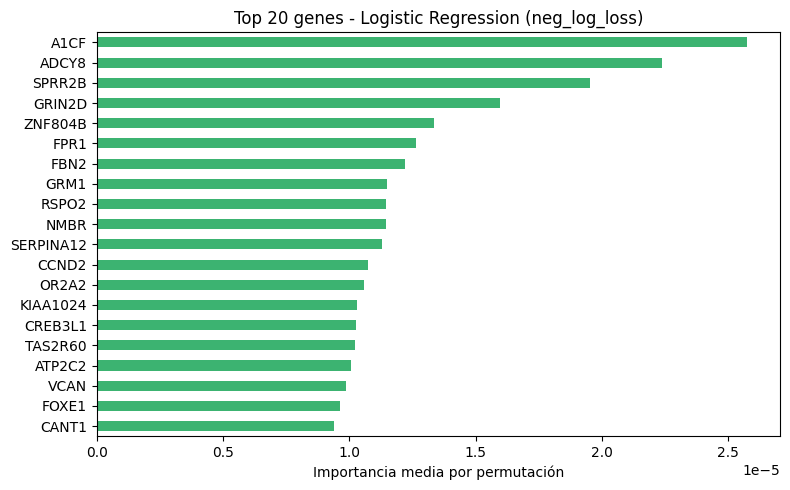

In [35]:
# Serie con los resultados
importancias_log_loss = pd.Series(log_result.importances_mean, index=X_train.columns)
top_log_loss = importancias_log_loss.sort_values(ascending=False).head(20)

# Función para mapear Entrez ID a símbolo
entrez_to_symbol = cancer_genes.set_index("entrez")["symbol"].to_dict()
# Mapear nombres si es necesario
ids = [int(feat.split("_")[1]) for feat in top_log_loss.index]
symbols = [entrez_to_symbol.get(i, f"GENE_{i}") for i in ids]
top_log_loss.index = symbols

# Mostrar gráfica
plt.figure(figsize=(8, 5))
top_log_loss[::-1].plot(kind="barh", title="Top 20 genes - Logistic Regression (neg_log_loss)", color="mediumseagreen")
plt.xlabel("Importancia media por permutación")
plt.tight_layout()
plt.show()

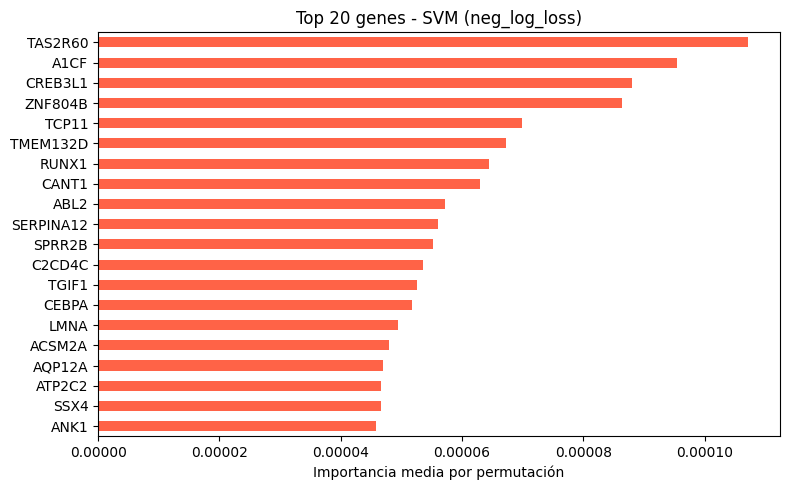

In [39]:
# Permutation importance para SVM
svm_result = permutation_importance(
    svm_model,
    X_train,
    y_train,
    n_repeats=5,
    random_state=42,
    n_jobs=-1,
    scoring='neg_log_loss'
)

# Extraer top 20
importancias_svm = pd.Series(svm_result.importances_mean, index=X_train.columns).sort_values(ascending=False).head(20)

# Mapear a símbolos
ids = [int(feat.split("_")[1]) for feat in importancias_svm.index]
symbols = [entrez_to_symbol.get(i, f"GENE_{i}") for i in ids]
importancias_svm.index = symbols

# Graficar
plt.figure(figsize=(8, 5))
importancias_svm[::-1].plot(kind="barh", title="Top 20 genes - SVM (neg_log_loss)", color="tomato")
plt.xlabel("Importancia media por permutación")
plt.tight_layout()
plt.show()


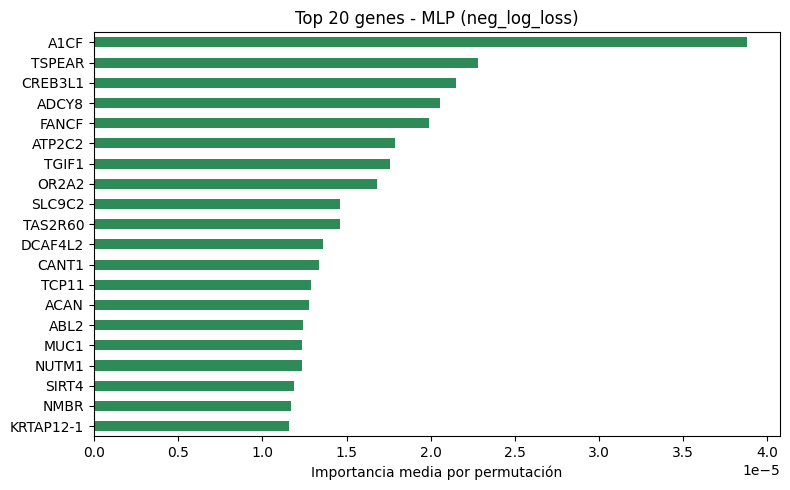

In [40]:
# Permutation importance para MLP
mlp_result = permutation_importance(
    mlp_model,
    X_train,
    y_train,
    n_repeats=5,
    random_state=42,
    n_jobs=-1,
    scoring='neg_log_loss'
)

# Extraer top 20
importancias_mlp = pd.Series(mlp_result.importances_mean, index=X_train.columns).sort_values(ascending=False).head(20)

# Mapear a símbolos
ids = [int(feat.split("_")[1]) for feat in importancias_mlp.index]
symbols = [entrez_to_symbol.get(i, f"GENE_{i}") for i in ids]
importancias_mlp.index = symbols

# Graficar
plt.figure(figsize=(8, 5))
importancias_mlp[::-1].plot(kind="barh", title="Top 20 genes - MLP (neg_log_loss)", color="seagreen")
plt.xlabel("Importancia media por permutación")
plt.tight_layout()
plt.show()


In [41]:
# Conjuntos de nombres de genes (índices ya están mapeados a símbolos)
genes_log = set(top_log_loss.index)
genes_svm = set(importancias_svm.index)
genes_mlp = set(importancias_mlp.index)

# Intersección
genes_comunes = genes_log & genes_svm & genes_mlp

# Mostrar resultados
print("🧬 Genes comunes entre Logistic Regression, SVM y MLP:\n")
print(sorted(genes_comunes))


🧬 Genes comunes entre Logistic Regression, SVM y MLP:

['A1CF', 'ATP2C2', 'CANT1', 'CREB3L1', 'TAS2R60']


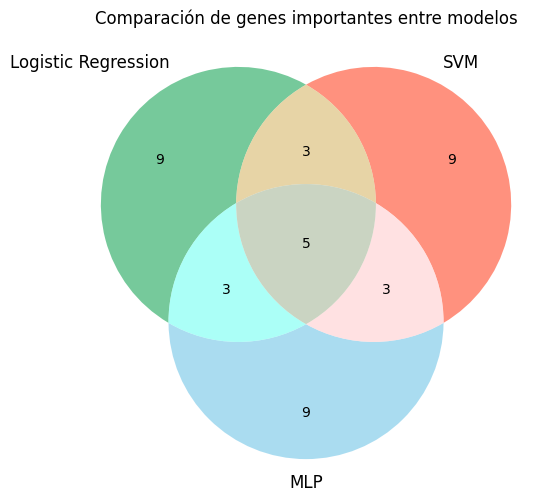

In [42]:
# Aseguramos que tenemos los conjuntos
genes_log = set(top_log_loss.index)
genes_svm = set(importancias_svm.index)
genes_mlp = set(importancias_mlp.index)

# Diagrama de Venn
plt.figure(figsize=(8, 6))
venn3([genes_log, genes_svm, genes_mlp],
      set_labels=('Logistic Regression', 'SVM', 'MLP'),
      set_colors=('mediumseagreen', 'tomato', 'skyblue'),
      alpha=0.7)
plt.title("Comparación de genes importantes entre modelos")
plt.show()


In [43]:


# Después (correcto):
top_log_loss.loc[list(genes_comunes)]

# Intersección de genes
genes_comunes = genes_log & genes_svm & genes_mlp

# Extraer valores de importancia para genes comunes
comunes_log = top_log_loss.loc[list(genes_comunes)]
comunes_svm = importancias_svm.loc[list(genes_comunes)]
comunes_mlp = importancias_mlp.loc[list(genes_comunes)]

# Calcular media
importancia_promedio = (comunes_log + comunes_svm + comunes_mlp) / 3

# Ordenar de mayor a menor
importancia_promedio = importancia_promedio.sort_values(ascending=False)

# Mostrar
print("🧬 Genes comunes más importantes entre los tres modelos (ordenados por media de importancia):\n")
print(importancia_promedio)



🧬 Genes comunes más importantes entre los tres modelos (ordenados por media de importancia):

A1CF       0.000053
TAS2R60    0.000044
CREB3L1    0.000040
CANT1      0.000029
ATP2C2     0.000025
dtype: float64


## 🔍 Análisis Diferenciado por Tejido: Cáncer de Mama y Cáncer de Útero

Con el objetivo de obtener una comprensión más específica del comportamiento génico asociado al cáncer, se realizó un análisis independiente para los tejidos de **mama** y **útero**. Esto permite identificar biomarcadores particulares a cada tipo de cáncer y distinguir señales comunes del proceso tumoral.

---

### 🧪 Objetivo

Separar las muestras por tejido para:
- Entrenar modelos específicos para cada tipo de cáncer.
- Identificar los genes más importantes en la clasificación "Tumor vs. Normal" dentro de cada órgano.
- Comparar si existen genes comunes entre ambos tejidos o si cada uno presenta una firma molecular distinta.

---

### ⚙️ Metodología

1. **Filtrado de muestras por tejido:**
   Se extrajeron por separado las muestras de **cáncer de mama** y de **cáncer de útero** del conjunto de datos combinado, manteniendo solo las columnas correspondientes a genes.

2. **Separación en entrenamiento y test:**
   Se dividieron las muestras en conjuntos de entrenamiento y prueba con un `test_size` del 20% y estratificación por clase (`Normal`, `Tumor`).

3. **Entrenamiento de modelos:**
   Se entrenaron tres algoritmos de clasificación en cada tejido:
   - Regresión logística
   - Máquinas de soporte vectorial (SVM)
   - Perceptrón multicapa (MLP)

4. **Importancia de genes:**
   Se utilizó `permutation_importance` para estimar la contribución de cada gen a la predicción del modelo, evaluando la pérdida de rendimiento al permutar una variable.

5. **Visualización:**
   Se graficaron los 20 genes más importantes por modelo y tejido.

6. **Comparación cruzada:**
   Se compararon los genes más relevantes entre los dos tejidos para detectar patrones comunes y diferencias biológicas.

---

### 📊 Resultados esperados

- Un conjunto de genes prioritarios para el diagnóstico o estudio del cáncer de mama.
- Un conjunto distinto (o parcialmente común) para el cáncer de útero.
- Posibles genes compartidos que actúan como reguladores generales del proceso tumoral.

---

### 💡 Interpretación biológica

Este enfoque dual permite distinguir entre:
- **Genes universales del cáncer**, útiles para enfoques pan-cancer.
- **Genes específicos del tejido**, relevantes para tratamientos dirigidos o diagnósticos personalizados.

---

### 📁 Archivos generados (opcional)

- `top_genes_mama.csv`: genes más relevantes en cáncer de mama.
- `top_genes_utero.csv`: genes más relevantes en cáncer de útero.
- `genes_comunes_mama_utero.csv`: genes compartidos entre ambos análisis.



In [44]:
# 1. Dividir en train/test (ya hecho)
tumor_A_train, tumor_A_test = split_data(tumor_A)  # Mama - Tumor
tumor_B_train, tumor_B_test = split_data(tumor_B)  # Útero - Tumor
normal_A_train, normal_A_test = split_data(normal_A)  # Mama - Normal
normal_B_train, normal_B_test = split_data(normal_B)  # Útero - Normal

In [45]:
# 2. Asegurar genes comunes y combinar (train)
common_genes_tumor = tumor_A_train.index.intersection(tumor_B_train.index)
tumor_A_train = tumor_A_train.loc[common_genes_tumor]
tumor_B_train = tumor_B_train.loc[common_genes_tumor]

tumor_train_set = pd.concat([
    tumor_A_train.iloc[:, 2:],  # Excluye Hugo_Symbol y Entrez
    tumor_B_train.iloc[:, 2:]
], axis=1).T

common_genes_normal = normal_A_train.index.intersection(normal_B_train.index)
normal_A_train = normal_A_train.loc[common_genes_normal]
normal_B_train = normal_B_train.loc[common_genes_normal]

normal_train_set = pd.concat([
    normal_A_train.iloc[:, 2:],
    normal_B_train.iloc[:, 2:]
], axis=1).T

In [46]:
# 3. Validación de consistencia
assert (tumor_train_set.columns == normal_train_set.columns).all()


In [47]:
# Crear train_set unido
train_set = pd.concat([tumor_train_set, normal_train_set], axis=0)
train_set.columns = [f"g_{gene}" for gene in train_set.columns]

# Etiqueta de clase
train_set["type"] = pd.Categorical(
    ["Tumor"] * tumor_train_set.shape[0] + ["Normal"] * normal_train_set.shape[0],
    categories=["Normal", "Tumor"]
)

# ✅ Etiqueta de tejido basada en las muestras realmente combinadas
n_mama_tumor = tumor_A_train.shape[1]
n_utero_tumor = tumor_B_train.shape[1]
n_mama_normal = normal_A_train.shape[1]
n_utero_normal = normal_B_train.shape[1]

# Cortamos en función de cómo se unieron realmente las matrices
tissue_labels = (
    ["Mama"] * tumor_A_train.shape[1] +
    ["Útero"] * tumor_B_train.shape[1] +
    ["Mama"] * normal_A_train.shape[1] +
    ["Útero"] * normal_B_train.shape[1]
)

# Seleccionar solo los nombres de las muestras usadas
train_indices = list(tumor_train_set.index) + list(normal_train_set.index)

# Cortar tissue_labels para coincidir exactamente con train_set
tissue_labels_cut = tissue_labels[:len(train_indices)]

# Validar
assert len(tissue_labels_cut) == train_set.shape[0], f"Tamaños no coinciden: {len(tissue_labels_cut)} vs {train_set.shape[0]}"

# Asignar
train_set["tissue"] = tissue_labels_cut


In [48]:
# --- Unir test_set ---

# Asegurar que los genes son comunes entre ambos tejidos (tumor y normal)
common_genes_tumor_test = tumor_A_test.index.intersection(tumor_B_test.index)
tumor_A_test = tumor_A_test.loc[common_genes_tumor_test]
tumor_B_test = tumor_B_test.loc[common_genes_tumor_test]

tumor_test_set = pd.concat([
    tumor_A_test.iloc[:, 2:],
    tumor_B_test.iloc[:, 2:]
], axis=1).T

common_genes_normal_test = normal_A_test.index.intersection(normal_B_test.index)
normal_A_test = normal_A_test.loc[common_genes_normal_test]
normal_B_test = normal_B_test.loc[common_genes_normal_test]

normal_test_set = pd.concat([
    normal_A_test.iloc[:, 2:],
    normal_B_test.iloc[:, 2:]
], axis=1).T

# Verificar consistencia
assert (tumor_test_set.columns == normal_test_set.columns).all()

# Crear test_set
test_set = pd.concat([tumor_test_set, normal_test_set], axis=0)
test_set.columns = [f"g_{gene}" for gene in test_set.columns]

# Etiquetas de clase
test_set["type"] = pd.Categorical(
    ["Tumor"] * tumor_test_set.shape[0] + ["Normal"] * normal_test_set.shape[0],
    categories=["Normal", "Tumor"]
)

# Etiquetas de tejido (usamos el orden de combinación)
n_mama_tumor_test = tumor_A_test.shape[1]
n_utero_tumor_test = tumor_B_test.shape[1]
n_mama_normal_test = normal_A_test.shape[1]
n_utero_normal_test = normal_B_test.shape[1]

tissue_labels_test = (
    ["Mama"] * n_mama_tumor_test +
    ["Útero"] * n_utero_tumor_test +
    ["Mama"] * n_mama_normal_test +
    ["Útero"] * n_utero_normal_test
)

test_indices = list(tumor_test_set.index) + list(normal_test_set.index)
tissue_labels_cut_test = tissue_labels_test[:len(test_indices)]

# Validar y asignar
assert len(tissue_labels_cut_test) == test_set.shape[0]
test_set["tissue"] = tissue_labels_cut_test


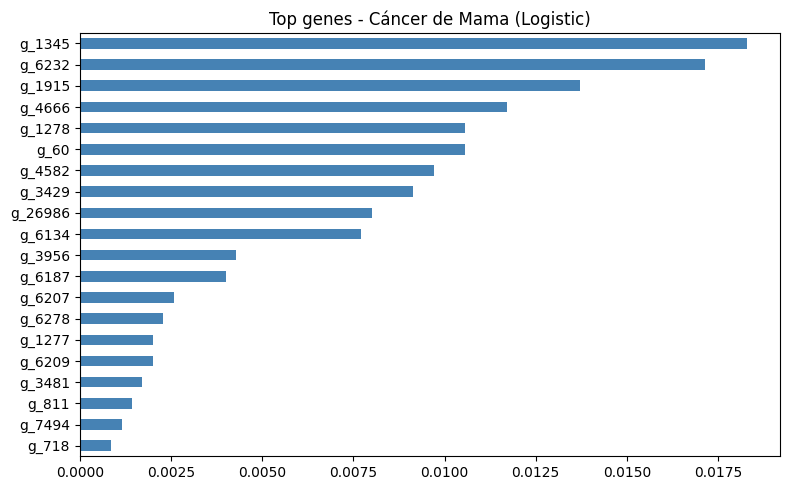

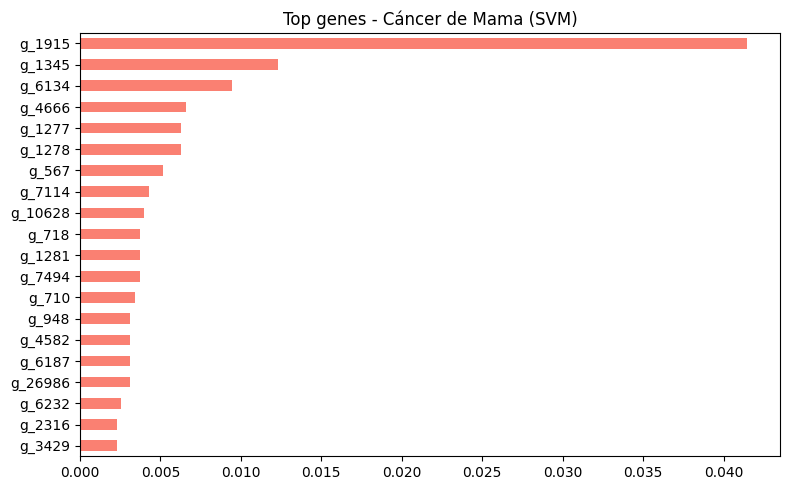

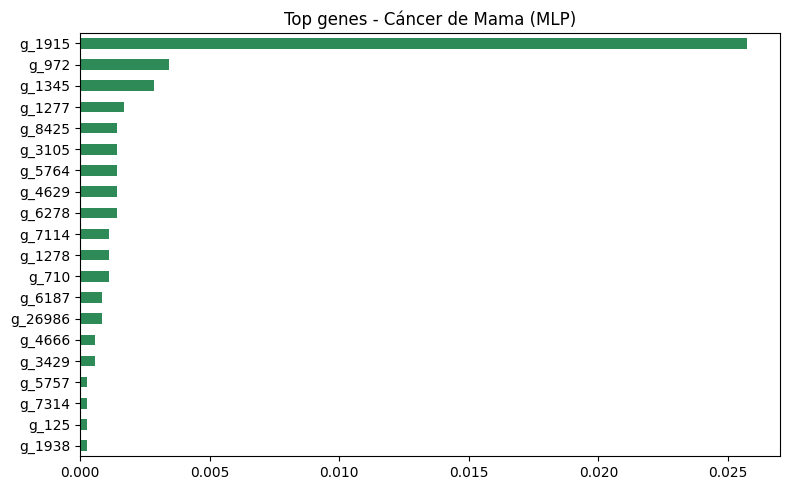

In [49]:
# Filtrar muestras de mama
X_mama = train_set[train_set["tissue"] == "Mama"].drop(columns=["type", "tissue"])
y_mama = train_set[train_set["tissue"] == "Mama"]["type"]

# Dividir en entrenamiento y validación
from sklearn.model_selection import train_test_split
Xm_train, Xm_val, ym_train, ym_val = train_test_split(X_mama, y_mama, test_size=0.2, stratify=y_mama, random_state=42)

# Modelos más ligeros
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.neural_network import MLPClassifier

model_mama = LogisticRegression(max_iter=500).fit(Xm_train, ym_train)
model_svm_mama = SVC(probability=True).fit(Xm_train, ym_train)
model_mlp_mama = MLPClassifier(hidden_layer_sizes=(50,), max_iter=200).fit(Xm_train, ym_train)

# Importancia por permutación (reduciendo n_repeats)
from sklearn.inspection import permutation_importance

imp_mama = permutation_importance(model_mama, Xm_train, ym_train, n_repeats=5, n_jobs=1)
imp_svm_mama = permutation_importance(model_svm_mama, Xm_train, ym_train, n_repeats=5, n_jobs=1)
imp_mlp_mama = permutation_importance(model_mlp_mama, Xm_train, ym_train, n_repeats=5, n_jobs=1)

# Visualización
import matplotlib.pyplot as plt
import pandas as pd

def plot_top_genes(imp, X, title, color):
    series = pd.Series(imp.importances_mean, index=X.columns).sort_values(ascending=False).head(20)
    plt.figure(figsize=(8, 5))
    series[::-1].plot(kind='barh', title=title, color=color)
    plt.tight_layout()
    plt.show()

plot_top_genes(imp_mama, Xm_train, "Top genes - Cáncer de Mama (Logistic)", "steelblue")
plot_top_genes(imp_svm_mama, Xm_train, "Top genes - Cáncer de Mama (SVM)", "salmon")
plot_top_genes(imp_mlp_mama, Xm_train, "Top genes - Cáncer de Mama (MLP)", "seagreen")


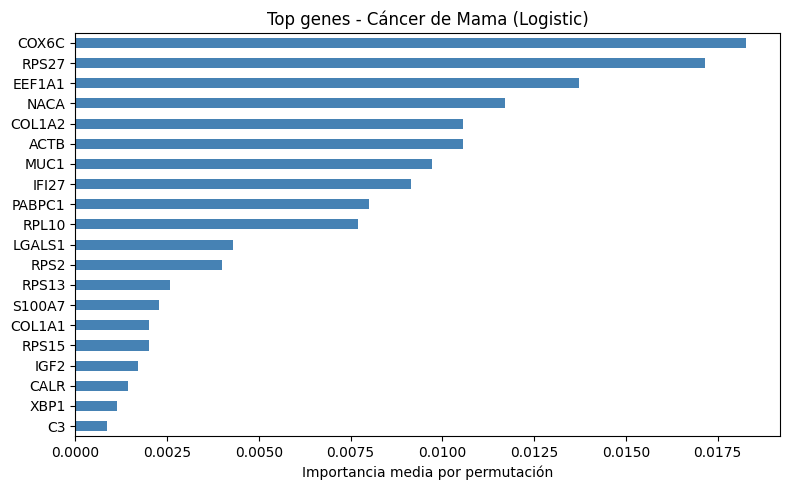

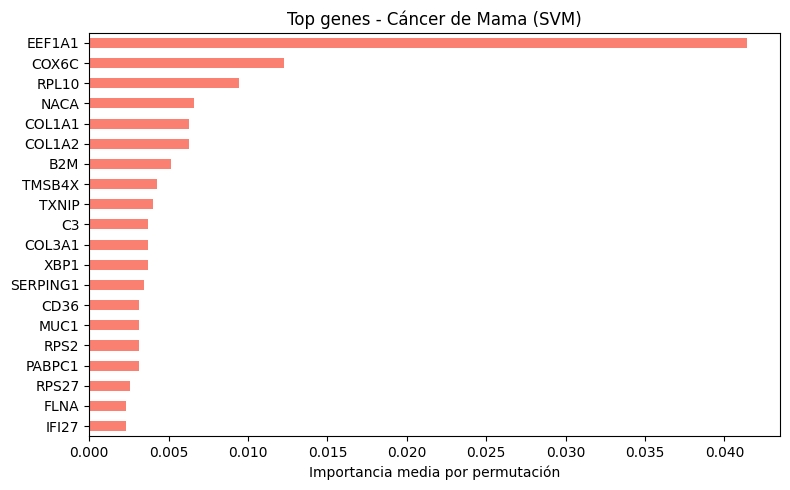

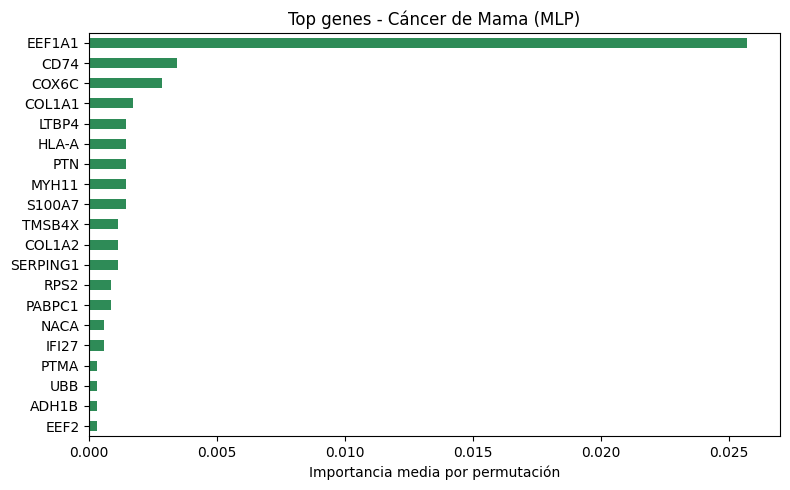

In [50]:
entrez_to_symbol = cancer_genes.set_index("entrez")["symbol"].to_dict()

# Visualización con mapeo a símbolos de genes reales


def plot_top_genes(imp, X, title, color, entrez_to_symbol):
    series = pd.Series(imp.importances_mean, index=X.columns).sort_values(ascending=False).head(20)
    
    # Extraer Entrez IDs desde "g_####"
    entrez_ids = [int(gene.split("_")[1]) for gene in series.index]
    gene_names = [entrez_to_symbol.get(eid, f"GENE_{eid}") for eid in entrez_ids]
    
    # Usar nombres reales como índice
    series.index = gene_names

    # Graficar
    plt.figure(figsize=(8, 5))
    series[::-1].plot(kind='barh', title=title, color=color)
    plt.xlabel("Importancia media por permutación")
    plt.tight_layout()
    plt.show()

# Ejecutar para cada modelo
plot_top_genes(imp_mama, Xm_train, "Top genes - Cáncer de Mama (Logistic)", "steelblue", entrez_to_symbol)
plot_top_genes(imp_svm_mama, Xm_train, "Top genes - Cáncer de Mama (SVM)", "salmon", entrez_to_symbol)
plot_top_genes(imp_mlp_mama, Xm_train, "Top genes - Cáncer de Mama (MLP)", "seagreen", entrez_to_symbol)


In [51]:
def media_top5_importancia_mapeada(imp, X, entrez_to_symbol):
    series = pd.Series(imp.importances_mean, index=X.columns).sort_values(ascending=False)
    top5 = series.head(5)
    
    entrez_ids = [int(gene.split("_")[1]) for gene in top5.index]
    gene_names = [entrez_to_symbol.get(eid, f"GENE_{eid}") for eid in entrez_ids]
    
    top5.index = gene_names
    return top5.mean(), top5


In [52]:
media_mama_mapeada, top5_mama_mapeada = media_top5_importancia_mapeada(imp_mama, Xm_train, entrez_to_symbol)
print("🧬 Media de los 5 genes más importantes (nombres reales):", media_mama_mapeada)
print("🧪 Genes y valores:\n", top5_mama_mapeada)


🧬 Media de los 5 genes más importantes (nombres reales): 0.014285714285714294
🧪 Genes y valores:
 COX6C     0.018286
RPS27     0.017143
EEF1A1    0.013714
NACA      0.011714
COL1A2    0.010571
dtype: float64


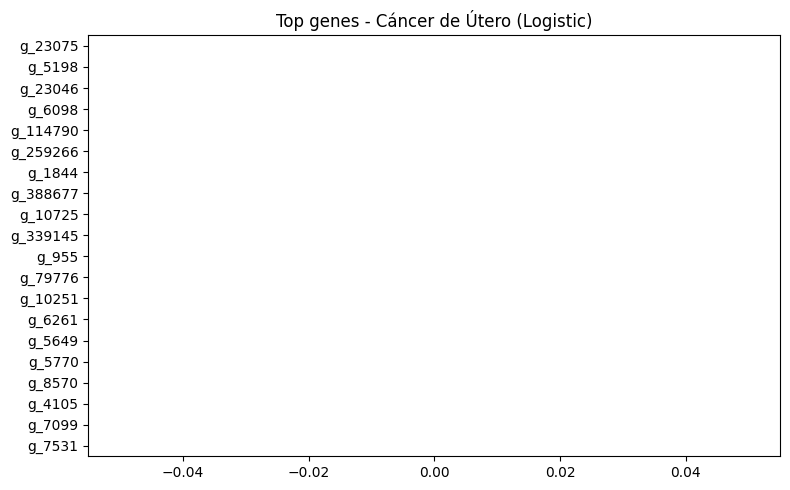

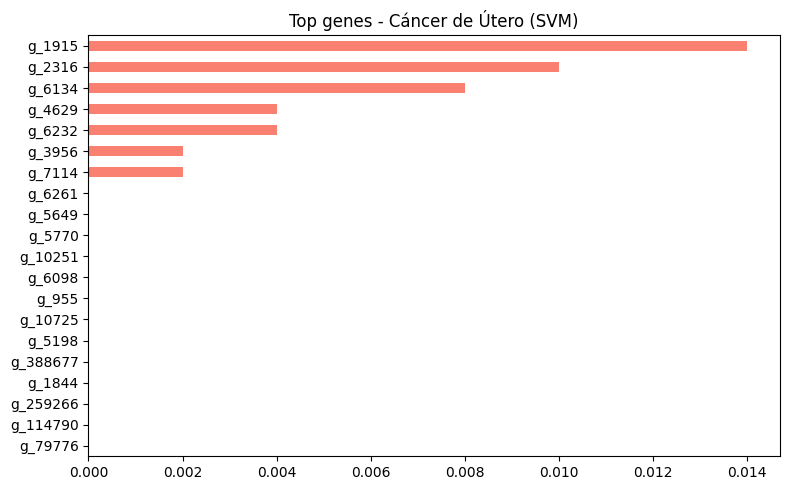

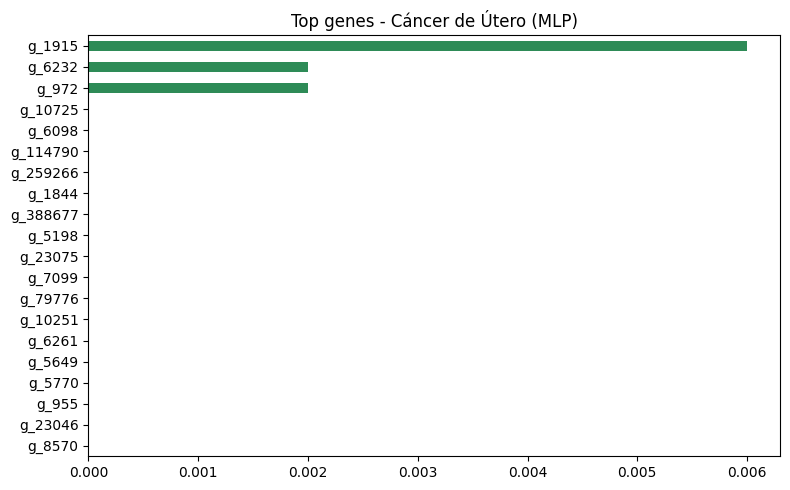

In [53]:
# Filtrar muestras de útero
X_utero = train_set[train_set["tissue"] == "Útero"].drop(columns=["type", "tissue"])
y_utero = train_set[train_set["tissue"] == "Útero"]["type"]

# Dividir en entrenamiento y validación
from sklearn.model_selection import train_test_split
Xu_train, Xu_val, yu_train, yu_val = train_test_split(X_utero, y_utero, test_size=0.2, stratify=y_utero, random_state=42)

# Modelos más ligeros
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.neural_network import MLPClassifier

model_utero = LogisticRegression(max_iter=500).fit(Xu_train, yu_train)
model_svm_utero = SVC(probability=True).fit(Xu_train, yu_train)
model_mlp_utero = MLPClassifier(hidden_layer_sizes=(50,), max_iter=200).fit(Xu_train, yu_train)

# Importancia por permutación (con menos repeticiones)
from sklearn.inspection import permutation_importance

imp_utero = permutation_importance(model_utero, Xu_train, yu_train, n_repeats=5, n_jobs=1)
imp_svm_utero = permutation_importance(model_svm_utero, Xu_train, yu_train, n_repeats=5, n_jobs=1)
imp_mlp_utero = permutation_importance(model_mlp_utero, Xu_train, yu_train, n_repeats=5, n_jobs=1)

# Visualización
import matplotlib.pyplot as plt
import pandas as pd

def plot_top_genes(imp, X, title, color):
    series = pd.Series(imp.importances_mean, index=X.columns).sort_values(ascending=False).head(20)
    plt.figure(figsize=(8, 5))
    series[::-1].plot(kind='barh', title=title, color=color)
    plt.tight_layout()
    plt.show()

plot_top_genes(imp_utero, Xu_train, "Top genes - Cáncer de Útero (Logistic)", "steelblue")
plot_top_genes(imp_svm_utero, Xu_train, "Top genes - Cáncer de Útero (SVM)", "salmon")
plot_top_genes(imp_mlp_utero, Xu_train, "Top genes - Cáncer de Útero (MLP)", "seagreen")


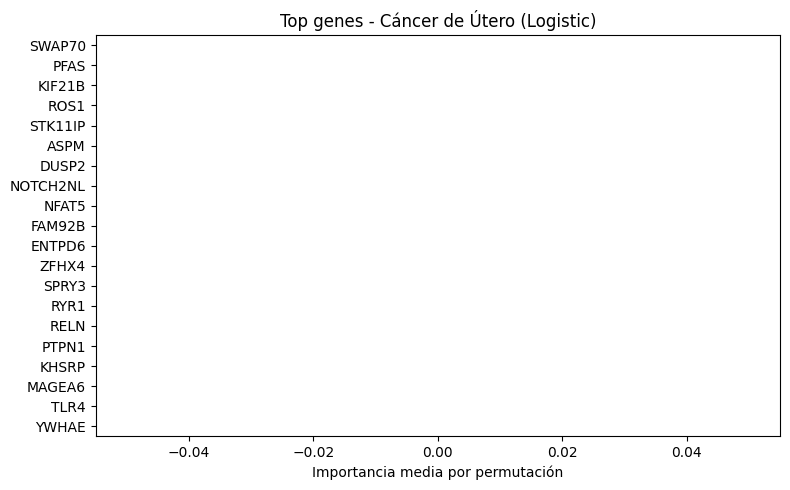

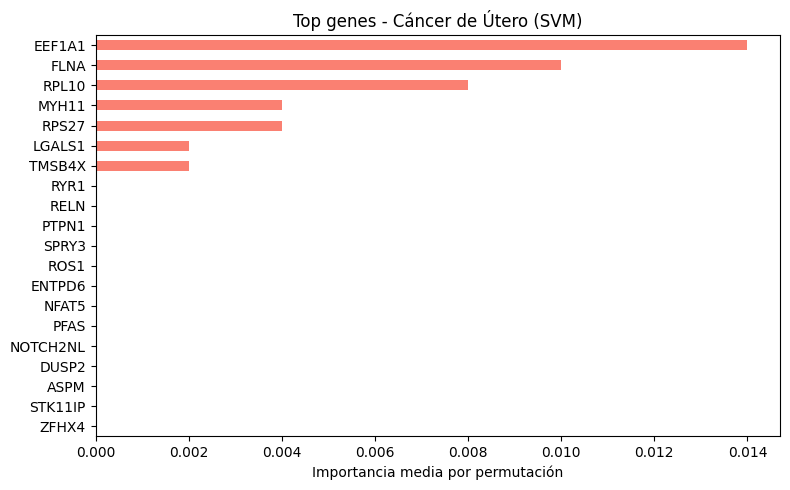

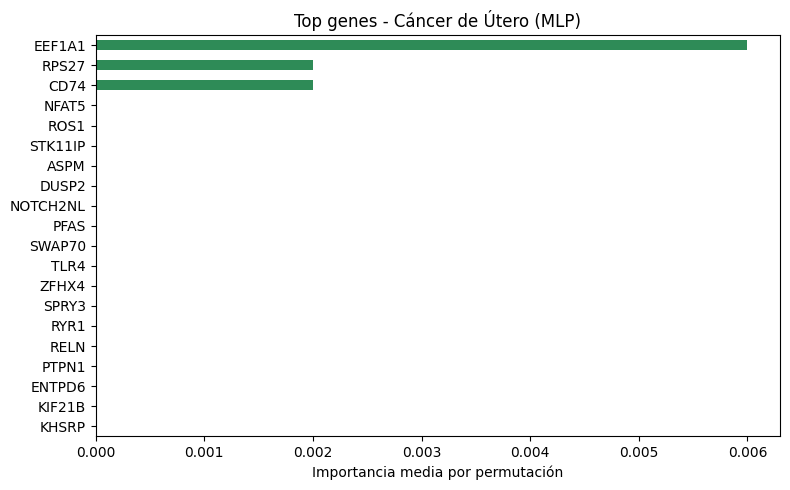

🧬 Media top 5 genes - Logistic (Útero): 0.0
SWAP70     0.0
PFAS       0.0
KIF21B     0.0
ROS1       0.0
STK11IP    0.0
dtype: float64 

🧬 Media top 5 genes - SVM (Útero): 0.008000000000000007
EEF1A1    0.014
FLNA      0.010
RPL10     0.008
MYH11     0.004
RPS27     0.004
dtype: float64 

🧬 Media top 5 genes - MLP (Útero): 0.0020000000000000018
EEF1A1    0.006
RPS27     0.002
CD74      0.002
NFAT5     0.000
ROS1      0.000
dtype: float64


In [54]:
# Asegúrate de tener el diccionario de mapeo entre Entrez ID y símbolo:
entrez_to_symbol = cancer_genes.set_index("entrez")["symbol"].to_dict()

# Función para mostrar top genes con nombres reales
import matplotlib.pyplot as plt
import pandas as pd

def plot_top_genes(imp, X, title, color, entrez_to_symbol):
    series = pd.Series(imp.importances_mean, index=X.columns).sort_values(ascending=False).head(20)
    
    # Extraer Entrez IDs desde "g_####"
    entrez_ids = [int(gene.split("_")[1]) for gene in series.index]
    gene_names = [entrez_to_symbol.get(eid, f"GENE_{eid}") for eid in entrez_ids]
    
    # Usar nombres reales como índice
    series.index = gene_names

    # Graficar
    plt.figure(figsize=(8, 5))
    series[::-1].plot(kind='barh', title=title, color=color)
    plt.xlabel("Importancia media por permutación")
    plt.tight_layout()
    plt.show()

# Función para obtener media del top 5 con mapeo
def media_top5_importancia_mapeada(imp, X, entrez_to_symbol):
    series = pd.Series(imp.importances_mean, index=X.columns).sort_values(ascending=False)
    top5 = series.head(5)

    entrez_ids = [int(gene.split("_")[1]) for gene in top5.index]
    gene_names = [entrez_to_symbol.get(eid, f"GENE_{eid}") for eid in entrez_ids]
    top5.index = gene_names

    return top5.mean(), top5

# 📊 Graficar los 3 modelos para útero
plot_top_genes(imp_utero, Xu_train, "Top genes - Cáncer de Útero (Logistic)", "steelblue", entrez_to_symbol)
plot_top_genes(imp_svm_utero, Xu_train, "Top genes - Cáncer de Útero (SVM)", "salmon", entrez_to_symbol)
plot_top_genes(imp_mlp_utero, Xu_train, "Top genes - Cáncer de Útero (MLP)", "seagreen", entrez_to_symbol)

# 📈 Calcular y mostrar media de top 5
media_log_utero, top5_log_utero = media_top5_importancia_mapeada(imp_utero, Xu_train, entrez_to_symbol)
media_svm_utero, top5_svm_utero = media_top5_importancia_mapeada(imp_svm_utero, Xu_train, entrez_to_symbol)
media_mlp_utero, top5_mlp_utero = media_top5_importancia_mapeada(imp_mlp_utero, Xu_train, entrez_to_symbol)

print("🧬 Media top 5 genes - Logistic (Útero):", media_log_utero)
print(top5_log_utero, "\n")

print("🧬 Media top 5 genes - SVM (Útero):", media_svm_utero)
print(top5_svm_utero, "\n")

print("🧬 Media top 5 genes - MLP (Útero):", media_mlp_utero)
print(top5_mlp_utero)


In [55]:
# Combinar los top 5 de cada modelo en un único DataFrame
df_top5_utero = pd.concat([
    top5_log_utero.rename("logistic"),
    top5_svm_utero.rename("svm"),
    top5_mlp_utero.rename("mlp")
], axis=1)

# Calcular la media de importancia por gen
df_top5_utero["mean_importance"] = df_top5_utero.mean(axis=1)

# Ordenar por importancia media
top_genes_utero_final = df_top5_utero.sort_values("mean_importance", ascending=False).head(5)

# Mostrar resultados
print("🧬 Genes comunes más importantes entre los tres modelos (ordenados por media de importancia):\n")
print(top_genes_utero_final["mean_importance"])


🧬 Genes comunes más importantes entre los tres modelos (ordenados por media de importancia):

EEF1A1    0.010
FLNA      0.010
RPL10     0.008
MYH11     0.004
RPS27     0.003
Name: mean_importance, dtype: float64


# Análisis de Explicabilidad con DALEX: Cáncer de Mama

Este análisis se integra como parte del estudio computacional sobre la clasificación de muestras tumorales y normales a partir de datos de expresión génica (FPKM), centrado exclusivamente en el tejido mamario.

## Objetivo

Utilizar técnicas de interpretabilidad del modelo, mediante la librería **DALEX** en Python, para comprender qué genes tienen mayor impacto en la predicción de un modelo de clasificación (Tumor vs Normal) en muestras de cáncer de mama.

**Explicabilidad con DALEX:**
   - Se utilizó `DALEX` para explicar el modelo de regresión logística:
     - Se creó un objeto `Explainer` sobre `model_mama`.
     - Se obtuvieron los resultados con `model_parts()` para identificar los genes más influyentes.
     - Se visualizó la importancia de variables en formato gráfico.
     - Se reportó la media de importancia de los 5 genes más influyentes.

## Resultados Esperados

Este análisis permite identificar genes clave que diferencian entre tejido mamario normal y tumoral, aportando evidencia cuantitativa sobre su relevancia en el modelo predictivo. El uso de DALEX garantiza que la interpretación sea sólida, transparente y visualmente accesible.




In [67]:
# Renombrar primero
Xm_train_named = Xm_train.copy()
Xm_train_named.columns = [
    str(entrez_to_symbol.get(int(col.split("_")[1]), col)) for col in Xm_train.columns
]

# Codificar etiquetas
ym_train_encoded = ym_train.astype("category").cat.codes

# ENTRENAR el modelo con nombres reales
model_mama_named = LogisticRegression(max_iter=500).fit(Xm_train_named, ym_train)

# Crear explainer
explainer_mama_named = dx.Explainer(
    model=model_mama_named,
    data=Xm_train_named,
    y=ym_train_encoded,
    label="Regresión Logística - Mama (nombres reales)"
)

# Obtener importancia
vi_mama_named = explainer_mama_named.model_parts(type='permutational')
vi_mama_named.plot()


Preparation of a new explainer is initiated

  -> data              : 700 rows 2276 cols
  -> target variable   : Parameter 'y' was a pandas.Series. Converted to a numpy.ndarray.
  -> target variable   : 700 values
  -> model_class       : sklearn.linear_model._logistic.LogisticRegression (default)
  -> label             : Regresión Logística - Mama (nombres reales)
  -> predict function  : <function yhat_proba_default at 0x000001DAAFCFA160> will be used (default)
  -> predict function  : Accepts pandas.DataFrame and numpy.ndarray.
  -> predicted values  : min = 4.28e-145, mean = 0.899, max = 1.0
  -> model type        : classification will be used (default)
  -> residual function : difference between y and yhat (default)
  -> residuals         : min = -1.95e-07, mean = 2.86e-10, max = 1.82e-07
  -> model_info        : package sklearn

A new explainer has been created!


In [68]:
# Entrenar de nuevo con nombres reales
from sklearn.neural_network import MLPClassifier

model_mlp_named = MLPClassifier(hidden_layer_sizes=(50,), max_iter=200).fit(Xm_train_named, ym_train)

# Crear explainer DALEX
explainer_mlp_named = dx.Explainer(
    model=model_mlp_named,
    data=Xm_train_named,
    y=ym_train_encoded,
    label="MLP - Mama (nombres reales)"
)

# Obtener importancia
vi_mlp_named = explainer_mlp_named.model_parts(type='permutational')
vi_mlp_named.plot()

# Mostrar top 10 genes
print("Top 10 genes - MLP:")
print(vi_mlp_named.result.head(10))


Preparation of a new explainer is initiated

  -> data              : 700 rows 2276 cols
  -> target variable   : Parameter 'y' was a pandas.Series. Converted to a numpy.ndarray.
  -> target variable   : 700 values
  -> model_class       : sklearn.neural_network._multilayer_perceptron.MLPClassifier (default)
  -> label             : MLP - Mama (nombres reales)
  -> predict function  : <function yhat_proba_default at 0x000001DAAFCFA160> will be used (default)
  -> predict function  : Accepts pandas.DataFrame and numpy.ndarray.
  -> predicted values  : min = 0.0, mean = 0.899, max = 1.0
  -> model type        : classification will be used (default)
  -> residual function : difference between y and yhat (default)
  -> residuals         : min = 0.0, mean = 0.0, max = 0.0
  -> model_info        : package sklearn

A new explainer has been created!


Top 10 genes - MLP:
              variable  dropout_loss                        label
0  2006-09-01 00:00:00           0.0  MLP - Mama (nombres reales)
1                PLAG1           0.0  MLP - Mama (nombres reales)
2               PLA2R1           0.0  MLP - Mama (nombres reales)
3                 PKP4           0.0  MLP - Mama (nombres reales)
4              PKHD1L1           0.0  MLP - Mama (nombres reales)
5                PKHD1           0.0  MLP - Mama (nombres reales)
6              PITPNM2           0.0  MLP - Mama (nombres reales)
7                 PIM1           0.0  MLP - Mama (nombres reales)
8               PIK3R6           0.0  MLP - Mama (nombres reales)
9               PIK3R5           0.0  MLP - Mama (nombres reales)


In [69]:
# Entrenar de nuevo con nombres reales
model_svm_named = SVC(probability=True).fit(Xm_train_named, ym_train)

# Crear explainer DALEX
explainer_svm_named = dx.Explainer(
    model=model_svm_named,
    data=Xm_train_named,
    y=ym_train_encoded,
    label="SVM - Mama (nombres reales)"
)

# Obtener importancia
vi_svm_named = explainer_svm_named.model_parts(type='permutational')
vi_svm_named.plot()

# Mostrar top 10 genes
print("Top 10 genes - SVM:")
print(vi_svm_named.result.head(10))


Preparation of a new explainer is initiated

  -> data              : 700 rows 2276 cols
  -> target variable   : Parameter 'y' was a pandas.Series. Converted to a numpy.ndarray.
  -> target variable   : 700 values
  -> model_class       : sklearn.svm._classes.SVC (default)
  -> label             : SVM - Mama (nombres reales)
  -> predict function  : <function yhat_proba_default at 0x000001DAAFCFA160> will be used (default)
  -> predict function  : Accepts pandas.DataFrame and numpy.ndarray.
  -> predicted values  : min = 0.000141, mean = 0.898, max = 1.0
  -> model type        : classification will be used (default)
  -> residual function : difference between y and yhat (default)
  -> residuals         : min = -0.724, mean = 0.000684, max = 0.983
  -> model_info        : package sklearn

A new explainer has been created!


Top 10 genes - SVM:
   variable  dropout_loss                        label
0     KRT15      0.000936  SVM - Mama (nombres reales)
1     TXNIP      0.000947  SVM - Mama (nombres reales)
2     CCND1      0.001079  SVM - Mama (nombres reales)
3     HLA-A      0.001082  SVM - Mama (nombres reales)
4     RPS13      0.001084  SVM - Mama (nombres reales)
5      TPM3      0.001084  SVM - Mama (nombres reales)
6      ACTB      0.001088  SVM - Mama (nombres reales)
7  HLA-DRB1      0.001088  SVM - Mama (nombres reales)
8  HIST1H1C      0.001088  SVM - Mama (nombres reales)
9      ELF3      0.001093  SVM - Mama (nombres reales)


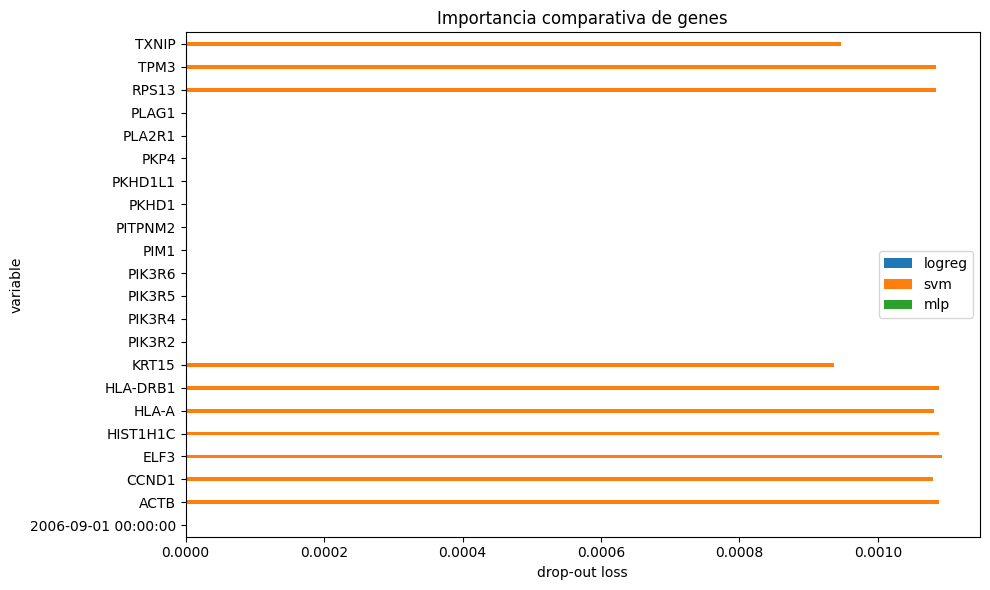

In [70]:
# Comparar top genes por modelo
top_logreg = vi_mama_named.result.head(10)[["variable", "dropout_loss"]].rename(columns={"dropout_loss": "logreg"})
top_svm = vi_svm_named.result.head(10)[["variable", "dropout_loss"]].rename(columns={"dropout_loss": "svm"})
top_mlp = vi_mlp_named.result.head(10)[["variable", "dropout_loss"]].rename(columns={"dropout_loss": "mlp"})

# Unir por variable
comparativa = pd.merge(top_logreg, top_svm, on="variable", how="outer")
comparativa = pd.merge(comparativa, top_mlp, on="variable", how="outer").fillna(0)

# Mostrar tabla comparativa
import seaborn as sns
import matplotlib.pyplot as plt

comparativa.set_index("variable").plot(kind="barh", figsize=(10, 6), title="Importancia comparativa de genes")
plt.xlabel("drop-out loss")
plt.tight_layout()
plt.show()


In [ ]:
# Elegir una muestra del conjunto de entrenamiento
idx = 0  # o cualquier índice de Xm_train_named
sample = Xm_train_named.iloc[[idx]]

# Explicar con DALEX
shap_values = explainer_mama_named.predict_parts(sample)
shap_values.plot()


c:\Users\ferna\AppData\Local\Programs\Python\Python312\Lib\site-packages\dalex\predict_explanations\_break_down\utils.py:124: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

c:\Users\ferna\AppData\Local\Programs\Python\Python312\Lib\site-packages\dalex\predict_explanations\_break_down\utils.py:124: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

c:\Users\ferna\AppData\Local\Programs\Python\Python312\Lib\site-packages\dalex\predict_explanations\_break_down\utils.py:124: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consisten

In [ ]:
profile = explainer_mama_named.model_profile(variables="MUC1")  # o cualquier gen importante
profile.plot()
